In [13]:
import datasets
from datasets import load_dataset
dataset = load_dataset("nateraw/pascal-voc-2012",split = 'train')


Using custom data configuration nateraw___pascal-voc-2012-c68607404d4811ac
Reusing dataset parquet (/aiffel/.cache/huggingface/datasets/parquet/nateraw___pascal-voc-2012-c68607404d4811ac/0.0.0/9296ce43568b20d72ff8ff8ecbc821a16b68e9b8b7058805ef11f06e035f911a)


In [14]:
print(dataset)

Dataset({
    features: ['image', 'mask'],
    num_rows: 2913
})


In [15]:
print(dataset[0]['image'].keys())
print(dataset[0]['mask'].keys())

dict_keys(['bytes', 'path'])
dict_keys(['bytes', 'path'])


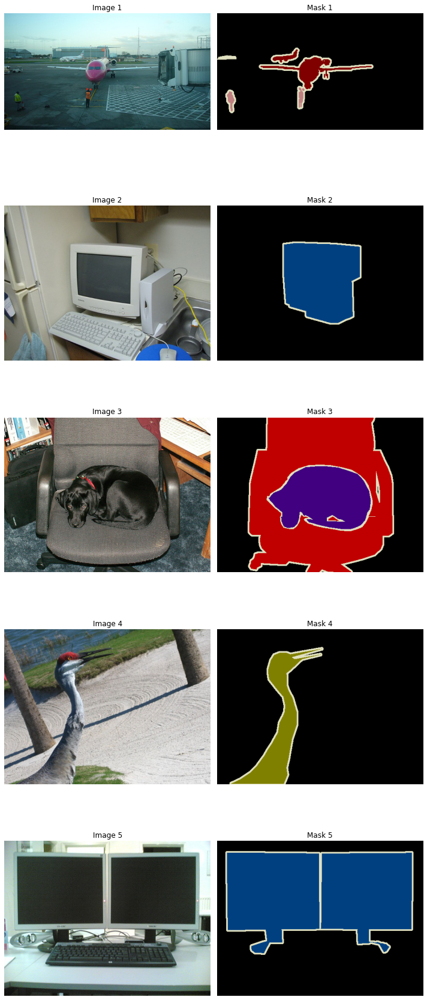

In [16]:
from PIL import Image
import io
import matplotlib.pyplot as plt
import numpy as np

def visualize_samples_bytes(dataset, num_samples=5):
    fig, axs = plt.subplots(num_samples, 2, figsize=(10, num_samples * 5))
    
    for i in range(num_samples):
        sample = dataset[i]
        
        # Convert bytes to numpy array for image
        image = np.array(Image.open(io.BytesIO(sample['image']['bytes'])))
        
        # Convert bytes to numpy array for mask
        mask = np.array(Image.open(io.BytesIO(sample['mask']['bytes'])))
        axs[i, 0].imshow(image)
        axs[i, 0].set_title(f"Image {i+1}")
        axs[i, 0].axis('off')

        axs[i, 1].imshow(mask)
        axs[i, 1].set_title(f"Mask {i+1}")
        axs[i, 1].axis('off')

    plt.tight_layout()
    plt.show()
    


visualize_samples_bytes(dataset)


In [17]:
# 데이터셋에서 처음 50개의 마스크 이미지를 가져옵니다.
sample_masks = [np.array(Image.open(io.BytesIO(dataset[i]['mask']['bytes']))) for i in range(50)]

# 이 마스크에서 고유한 색상을 추출
unique_colors = set()
for mask in sample_masks:
    unique_colors.update(tuple(v) for m in mask for v in m)

# 이 고유한 색상을 기반으로 컬러맵 딕셔너리를 구성
generated_colormap = {color: idx for idx, color in enumerate(unique_colors)}

# 컬러맵을 바탕으로 클래스 수를 확인
num_classes = len(generated_colormap)

In [18]:
print(num_classes)

22


In [19]:
def encode_mask(mask):
    """Convert mask's RGB values to class indices"""
    mask_encoded = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int32)
    for rgb, idx in generated_colormap.items():
        rgb = np.array(rgb)
        mask_match = (mask[..., 0] == rgb[0]) & (mask[..., 1] == rgb[1]) & (mask[..., 2] == rgb[2])
        mask_encoded[mask_match] = idx
    return mask_encoded

def decode_mask(mask_encoded):
    """Convert mask's class indices back to RGB values"""
    mask = np.zeros((mask_encoded.shape[0], mask_encoded.shape[1], 3), dtype=np.uint8)
    for rgb, idx in generated_colormap.items():
        mask[mask_encoded == idx] = rgb
    return mask

In [20]:
from sklearn.model_selection import train_test_split

train_data, val_data = train_test_split(dataset, test_size=0.20, random_state=42)

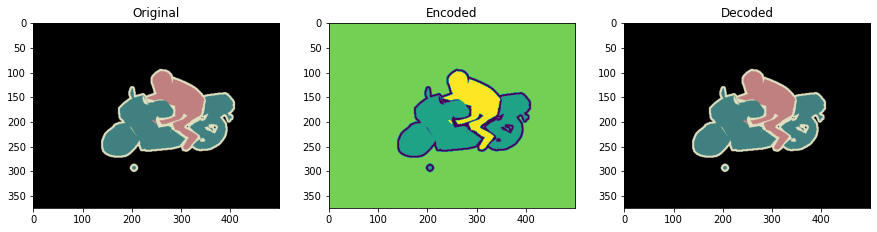

In [21]:
# 인코딩 및 디코딩 테스트
test_mask = np.array(Image.open(io.BytesIO(val_data['mask'][0]['bytes'])))
encoded = encode_mask(test_mask)
decoded = decode_mask(encoded)

plt.figure(figsize=(15,5))
plt.subplot(1, 3, 1)
plt.imshow(test_mask)
plt.title("Original")

plt.subplot(1, 3, 2)
plt.imshow(encoded)
plt.title("Encoded")

plt.subplot(1, 3, 3)
plt.imshow(decoded)
plt.title("Decoded")
plt.show()

In [22]:
from skimage.transform import resize

def preprocess_sample(data, resize_size=(512, 512), crop_size=(256, 256)):
    # Convert bytes to numpy array for image and mask
    image = np.array(Image.open(io.BytesIO(data['image']['bytes'])))
    mask = np.array(Image.open(io.BytesIO(data['mask']['bytes'])))

    # Resize image and mask to target size
    image = resize(image, resize_size, mode='reflect', anti_aliasing=True)
    mask = resize(mask, resize_size, mode='reflect', anti_aliasing=False, order=0, preserve_range=True).astype(np.uint8)

    # Crop to the center (more informations in the middle)
    start_x = (resize_size[0] - crop_size[0]) // 2
    start_y = (resize_size[1] - crop_size[1]) // 2
    end_x = start_x + crop_size[0]
    end_y = start_y + crop_size[1]

    image = image[start_x:end_x, start_y:end_y]
    mask = mask[start_x:end_x, start_y:end_y]

    # Normalize image to [0, 1]
    image = image / 255.0
    mask = encode_mask(mask)
    
    return image, mask



In [23]:
from tensorflow.keras.utils import Sequence


class PascalVOCDataGenerator(Sequence):
    def __init__(self, dataset, batch_size=32, target_size=(256, 256), shuffle=True):
        self.dataset = dataset
        self.batch_size = batch_size
        self.target_size = target_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(self.dataset))
        if self.shuffle:
            np.random.shuffle(self.indexes)

    def __len__(self):
        # Calculate the number of batches per epoch
        return int(np.ceil(len(self.dataset) / self.batch_size))

    def __getitem__(self, index):
        # Get batch indexes
        batch_indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        
        # Create batch data arrays
        batch_images = []
        batch_masks = []

        # For each index, preprocess the sample and append to batch arrays
        for idx in batch_indexes:
            data = {
                'image': self.dataset['image'][idx],
                'mask': self.dataset['mask'][idx]
            }
            image, mask = preprocess_sample(data, resize_size=(512, 512), crop_size=self.target_size)
            batch_images.append(image)
            batch_masks.append(mask[..., np.newaxis])  # adding an additional dimension to the mask

        return np.array(batch_images), np.array(batch_masks)

    def on_epoch_end(self):
        # Shuffle indexes after each epoch if shuffle is set to True
        if self.shuffle:
            np.random.shuffle(self.indexes)




In [26]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def build_unet(input_shape=(256, 256, 3), num_classes=22):
    inputs = Input(input_shape)
    
    # Contracting path (Encoder)
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)
    
    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(p3)
    c4 = Conv2D(256, (3, 3), activation='relu', padding='same')(c4)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(p4)
    c5 = Conv2D(512, (3, 3), activation='relu', padding='same')(c5)
    
    # Expansive path (Decoder)
    u6 = UpSampling2D((2, 2))(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(256, (3, 3), activation='relu', padding='same')(u6)
    c6 = Conv2D(256, (3, 3), activation='relu', padding='same')(c6)

    u7 = UpSampling2D((2, 2))(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(128, (3, 3), activation='relu', padding='same')(u7)
    c7 = Conv2D(128, (3, 3), activation='relu', padding='same')(c7)

    u8 = UpSampling2D((2, 2))(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(64, (3, 3), activation='relu', padding='same')(u8)
    c8 = Conv2D(64, (3, 3), activation='relu', padding='same')(c8)

    u9 = UpSampling2D((2, 2))(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(32, (3, 3), activation='relu', padding='same')(u9)
    c9 = Conv2D(32, (3, 3), activation='relu', padding='same')(c9)
    
    # Output layer
    outputs = Conv2D(num_classes, (1, 1), activation='softmax')(c9)
    
    model = tf.keras.Model(inputs=[inputs], outputs=[outputs])
    
    return model


model = build_unet()
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

Epoch 1/100
1/1 [==============================] - 7s 7s/step - loss: 3.0910 - accuracy: 0.0013 - val_loss: 3.0894 - val_accuracy: 0.0000e+00


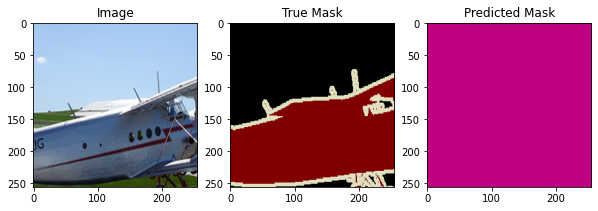

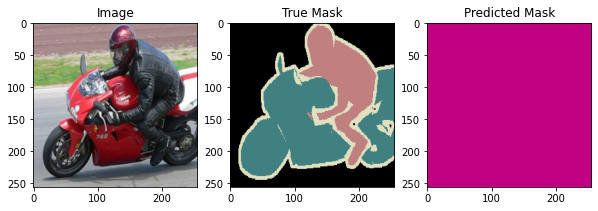

Epoch 2/100
1/1 [==============================] - 1s 669ms/step - loss: 3.0869 - accuracy: 0.0000e+00 - val_loss: 3.0798 - val_accuracy: 0.0000e+00


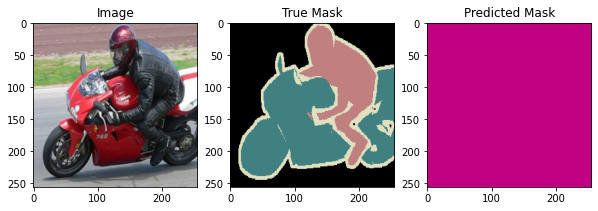

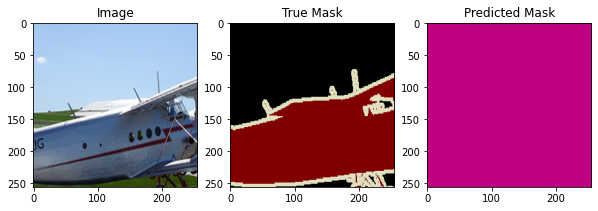

Epoch 3/100
1/1 [==============================] - 0s 496ms/step - loss: 3.0737 - accuracy: 0.0000e+00 - val_loss: 3.0106 - val_accuracy: 0.0000e+00


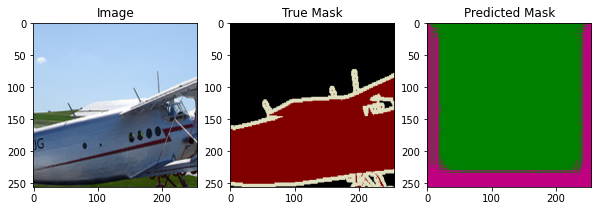

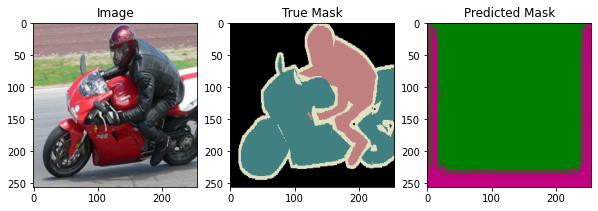

Epoch 4/100
1/1 [==============================] - 1s 640ms/step - loss: 2.9417 - accuracy: 0.0000e+00 - val_loss: 4.9058 - val_accuracy: 0.0000e+00


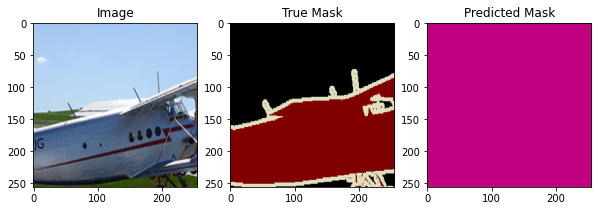

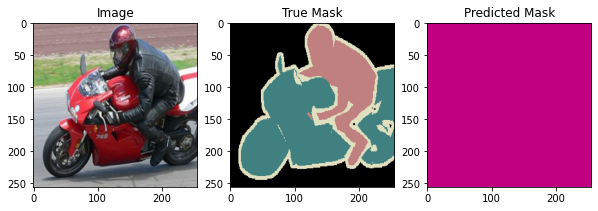

Epoch 5/100
1/1 [==============================] - 0s 487ms/step - loss: 3.2423 - accuracy: 0.0000e+00 - val_loss: 2.9255 - val_accuracy: 0.0000e+00


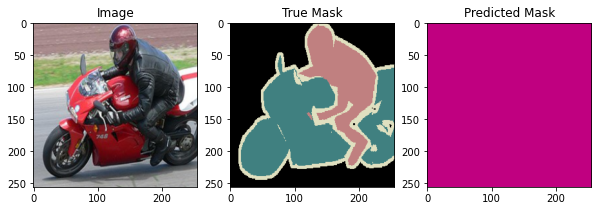

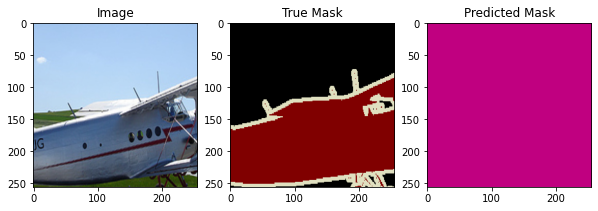

Epoch 6/100
1/1 [==============================] - 1s 627ms/step - loss: 2.8076 - accuracy: 0.0000e+00 - val_loss: 3.0190 - val_accuracy: 0.0000e+00


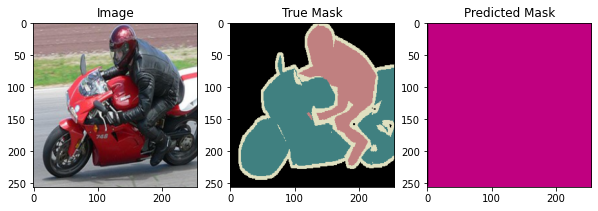

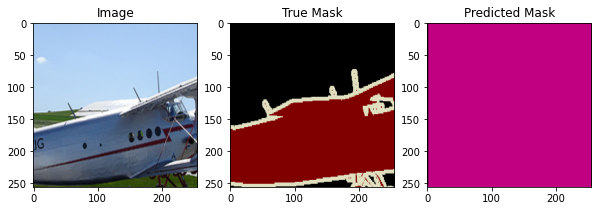

Epoch 7/100
1/1 [==============================] - 1s 616ms/step - loss: 2.9842 - accuracy: 0.0000e+00 - val_loss: 3.0352 - val_accuracy: 0.0000e+00


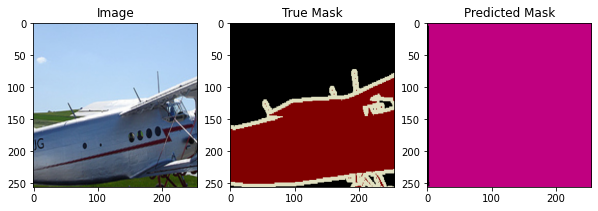

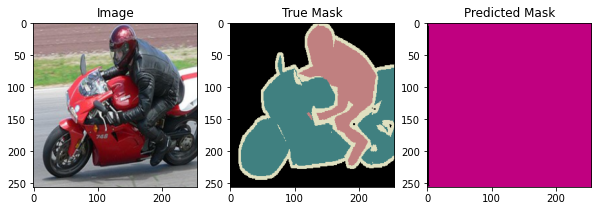

Epoch 8/100
1/1 [==============================] - 0s 382ms/step - loss: 3.0129 - accuracy: 0.0000e+00 - val_loss: 3.0326 - val_accuracy: 0.0000e+00


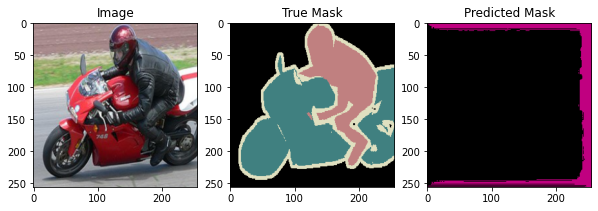

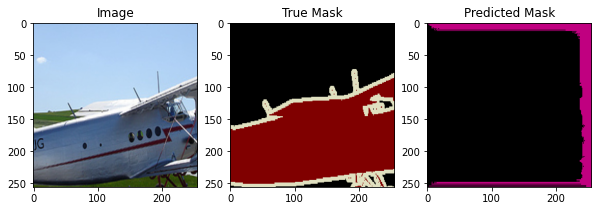

Epoch 9/100
1/1 [==============================] - 1s 620ms/step - loss: 3.0125 - accuracy: 0.0000e+00 - val_loss: 3.0201 - val_accuracy: 0.0000e+00


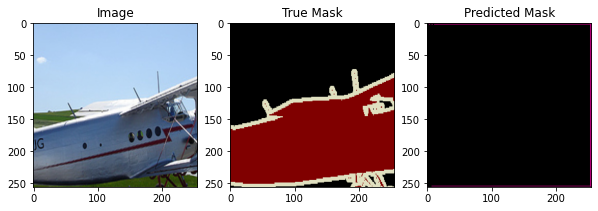

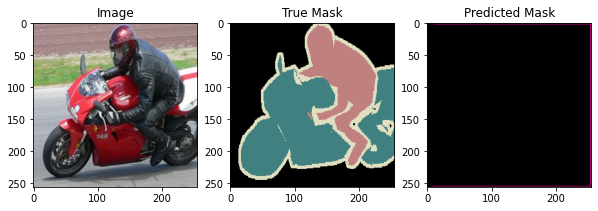

Epoch 10/100
1/1 [==============================] - 0s 379ms/step - loss: 2.9996 - accuracy: 0.0000e+00 - val_loss: 2.9955 - val_accuracy: 0.0000e+00


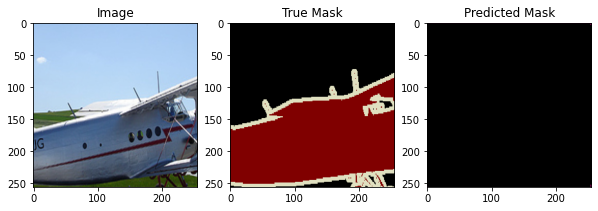

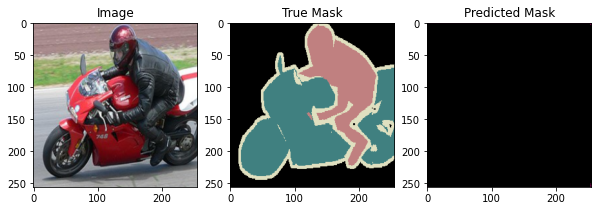

Epoch 11/100
1/1 [==============================] - 0s 496ms/step - loss: 2.9728 - accuracy: 0.0000e+00 - val_loss: 2.9497 - val_accuracy: 0.0000e+00


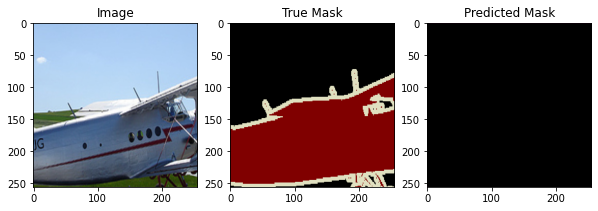

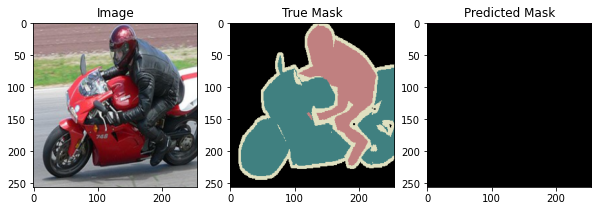

Epoch 12/100
1/1 [==============================] - 1s 506ms/step - loss: 2.9192 - accuracy: 0.0000e+00 - val_loss: 2.8620 - val_accuracy: 0.0000e+00


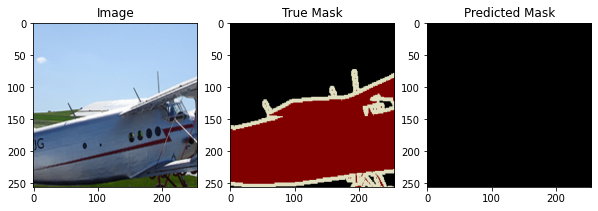

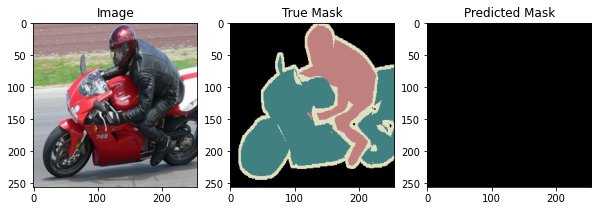

Epoch 13/100
1/1 [==============================] - 0s 373ms/step - loss: 2.8131 - accuracy: 0.0000e+00 - val_loss: 2.7023 - val_accuracy: 0.0000e+00


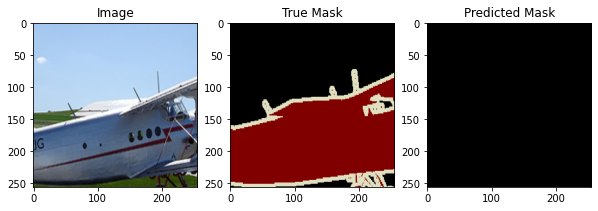

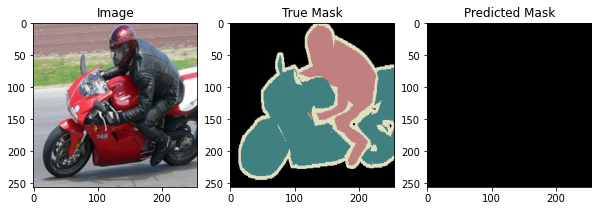

Epoch 14/100
1/1 [==============================] - 1s 659ms/step - loss: 2.6025 - accuracy: 0.0000e+00 - val_loss: 2.5264 - val_accuracy: 0.0000e+00


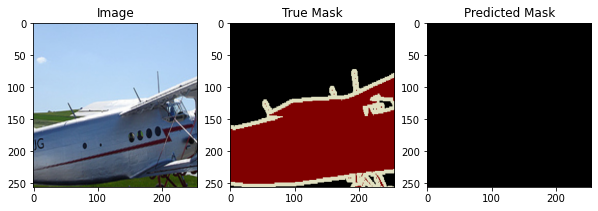

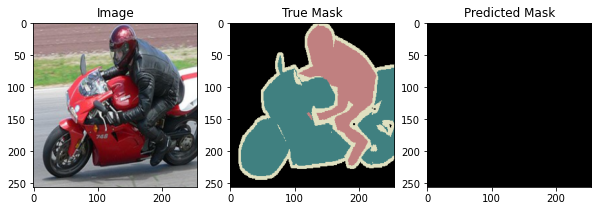

Epoch 15/100
1/1 [==============================] - 1s 632ms/step - loss: 2.2533 - accuracy: 0.0000e+00 - val_loss: 3.1876 - val_accuracy: 0.0000e+00


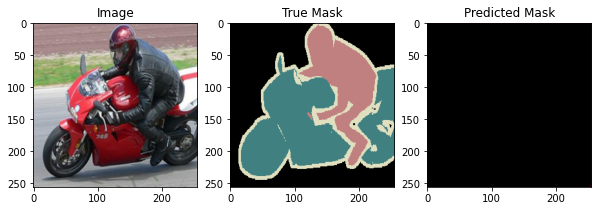

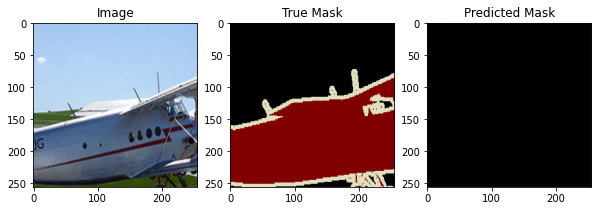

Epoch 16/100
1/1 [==============================] - 1s 614ms/step - loss: 2.1930 - accuracy: 0.0000e+00 - val_loss: 3.5556 - val_accuracy: 0.0000e+00


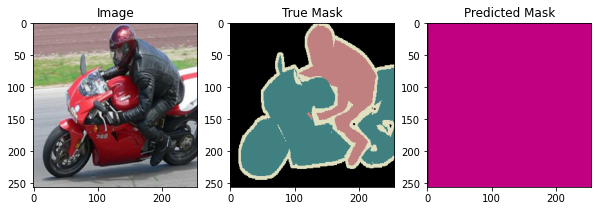

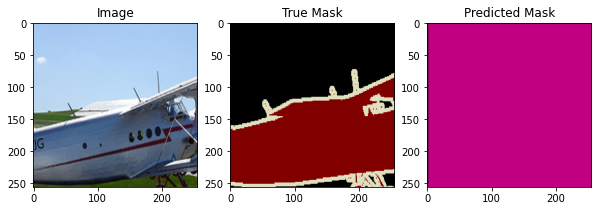

Epoch 17/100
1/1 [==============================] - 1s 605ms/step - loss: 2.0772 - accuracy: 0.0000e+00 - val_loss: 3.1968 - val_accuracy: 0.0000e+00


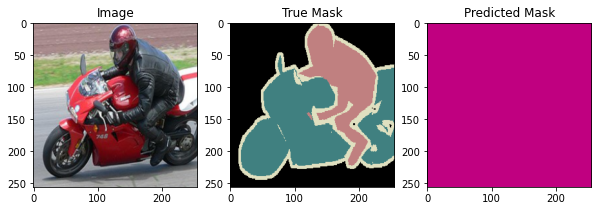

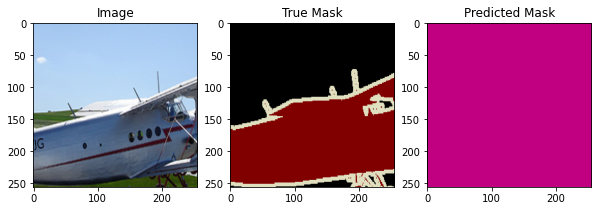

Epoch 18/100
1/1 [==============================] - 1s 601ms/step - loss: 1.8729 - accuracy: 0.0000e+00 - val_loss: 2.9898 - val_accuracy: 0.0000e+00


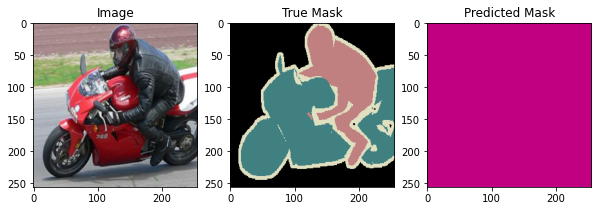

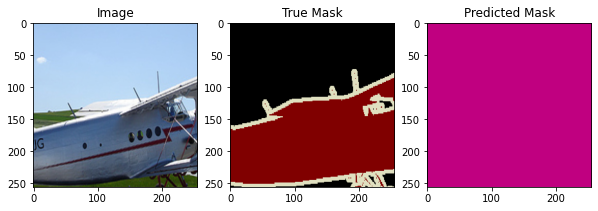

Epoch 19/100
1/1 [==============================] - 0s 345ms/step - loss: 1.8440 - accuracy: 0.0000e+00 - val_loss: 3.0434 - val_accuracy: 0.0000e+00


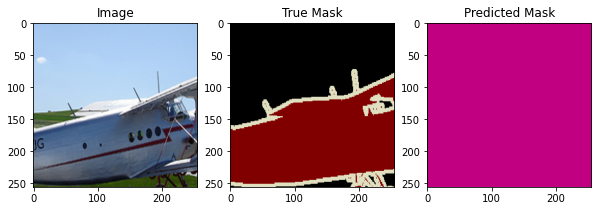

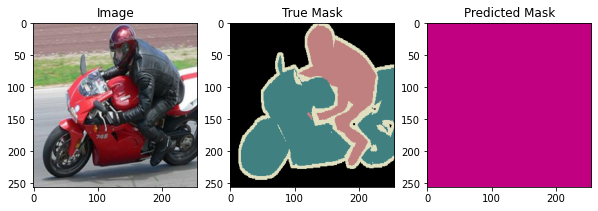

Epoch 20/100
1/1 [==============================] - 1s 598ms/step - loss: 1.8162 - accuracy: 0.0000e+00 - val_loss: 3.2830 - val_accuracy: 0.0000e+00


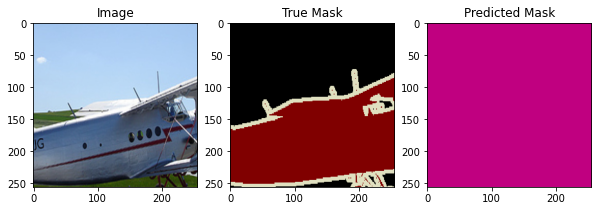

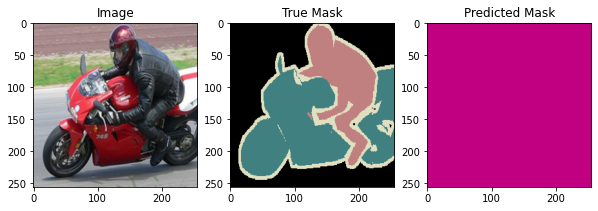

Epoch 21/100
1/1 [==============================] - 1s 616ms/step - loss: 1.7302 - accuracy: 0.0000e+00 - val_loss: 3.7527 - val_accuracy: 0.0000e+00


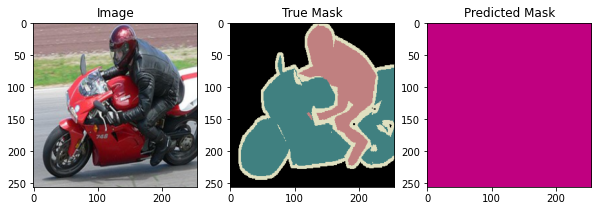

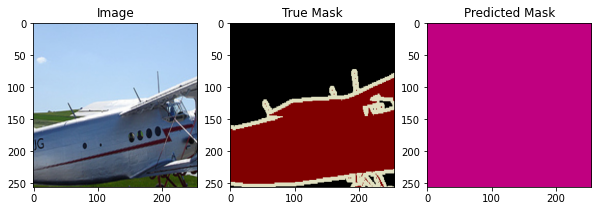

Epoch 22/100
1/1 [==============================] - 1s 514ms/step - loss: 1.6605 - accuracy: 0.0000e+00 - val_loss: 4.2668 - val_accuracy: 0.0000e+00


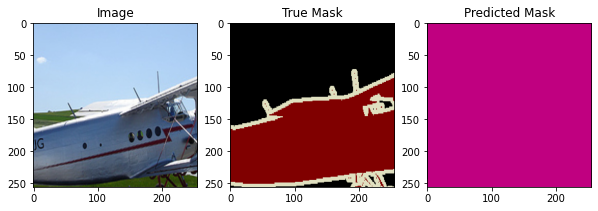

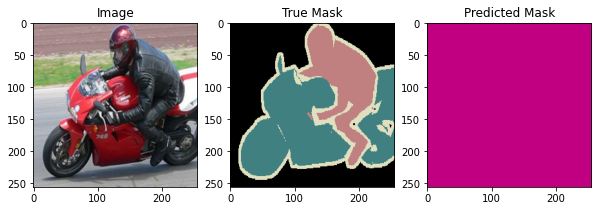

Epoch 23/100
1/1 [==============================] - 0s 339ms/step - loss: 1.6277 - accuracy: 0.0000e+00 - val_loss: 4.3174 - val_accuracy: 0.0000e+00


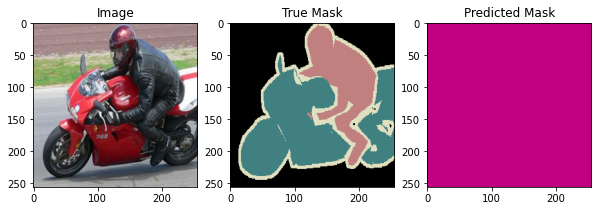

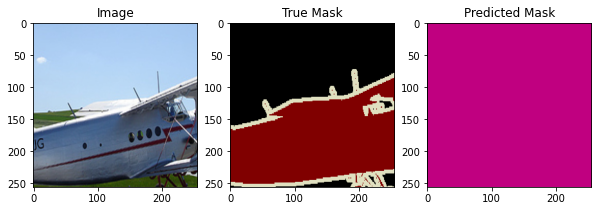

Epoch 24/100
1/1 [==============================] - 0s 480ms/step - loss: 1.5501 - accuracy: 0.0000e+00 - val_loss: 4.2011 - val_accuracy: 0.0000e+00


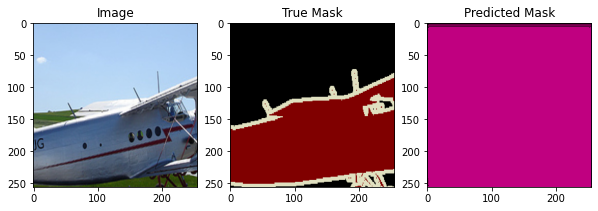

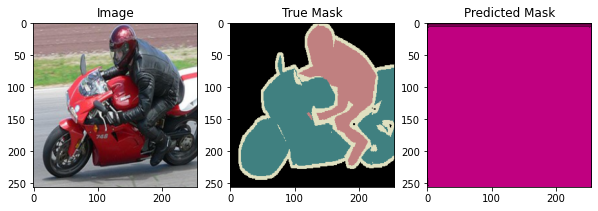

Epoch 25/100
1/1 [==============================] - 0s 468ms/step - loss: 1.5104 - accuracy: 0.0000e+00 - val_loss: 4.1429 - val_accuracy: 0.0000e+00


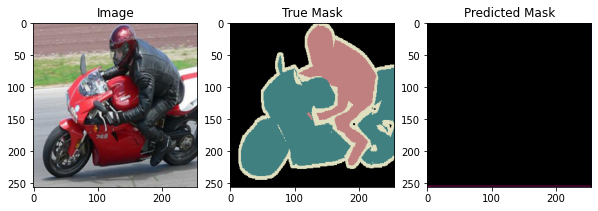

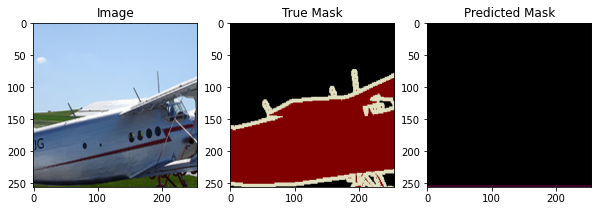

Epoch 26/100
1/1 [==============================] - 1s 511ms/step - loss: 1.5054 - accuracy: 0.0000e+00 - val_loss: 4.1098 - val_accuracy: 0.0000e+00


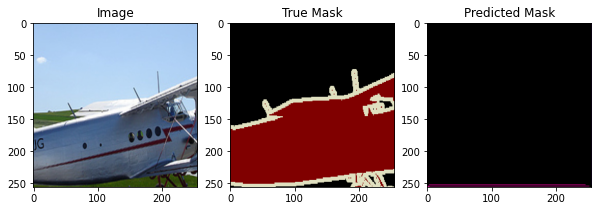

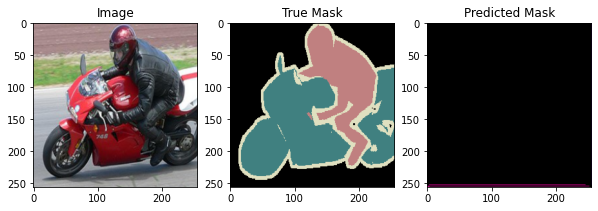

Epoch 27/100
1/1 [==============================] - 1s 596ms/step - loss: 1.4558 - accuracy: 0.0000e+00 - val_loss: 4.1552 - val_accuracy: 0.0000e+00


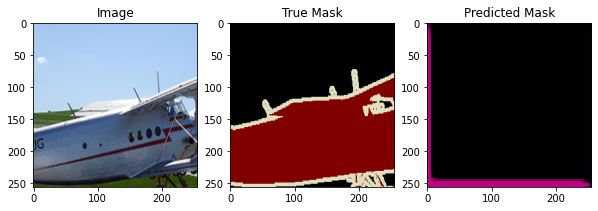

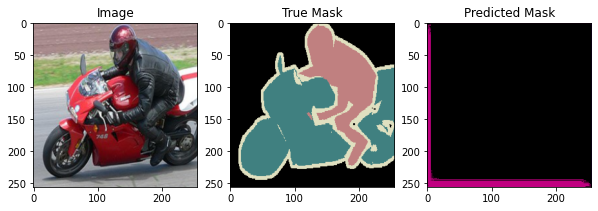

Epoch 28/100
1/1 [==============================] - 1s 641ms/step - loss: 1.3761 - accuracy: 0.0000e+00 - val_loss: 4.3155 - val_accuracy: 0.0000e+00


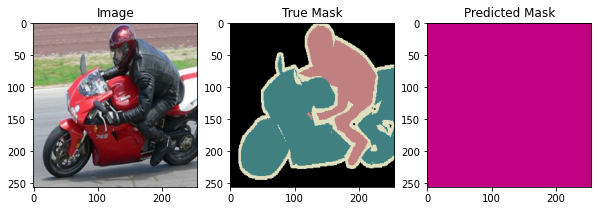

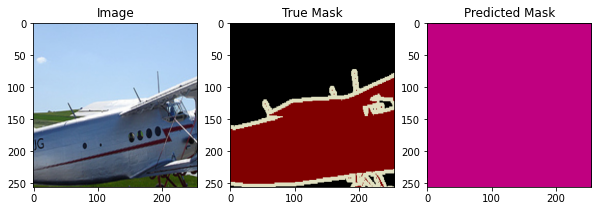

Epoch 29/100
1/1 [==============================] - 1s 508ms/step - loss: 1.3202 - accuracy: 0.0000e+00 - val_loss: 4.4932 - val_accuracy: 0.0000e+00


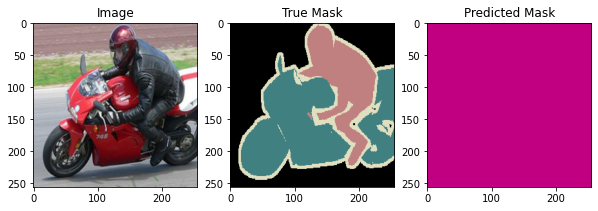

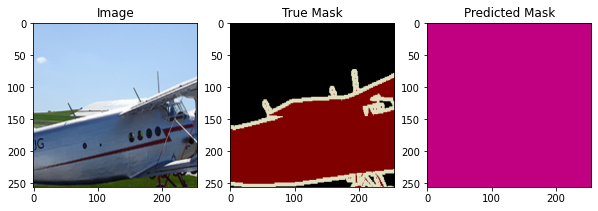

Epoch 30/100
1/1 [==============================] - 0s 473ms/step - loss: 1.3158 - accuracy: 0.0000e+00 - val_loss: 4.3810 - val_accuracy: 0.0000e+00


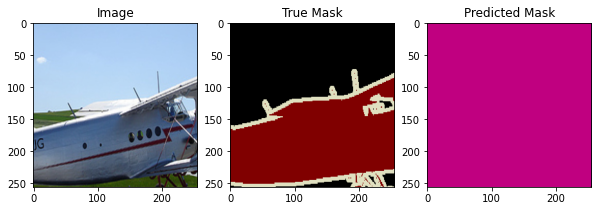

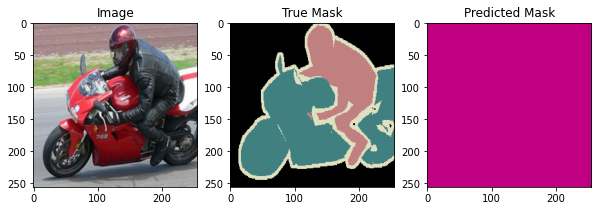

Epoch 31/100
1/1 [==============================] - 1s 638ms/step - loss: 1.2938 - accuracy: 0.0000e+00 - val_loss: 4.2251 - val_accuracy: 0.0039


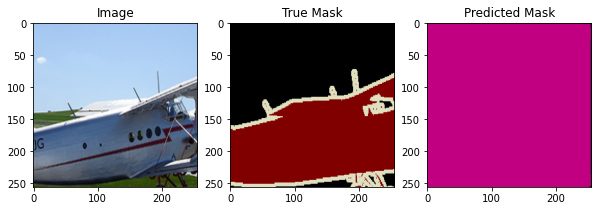

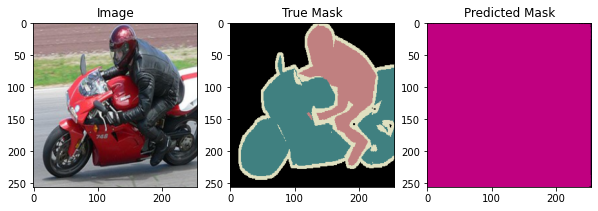

Epoch 32/100
1/1 [==============================] - 1s 596ms/step - loss: 1.2832 - accuracy: 0.0039 - val_loss: 4.3709 - val_accuracy: 0.0077


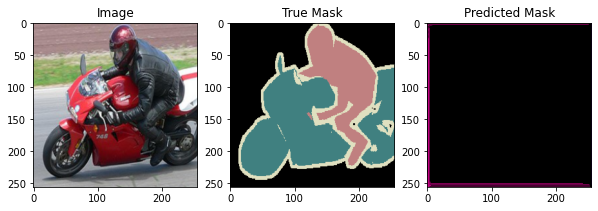

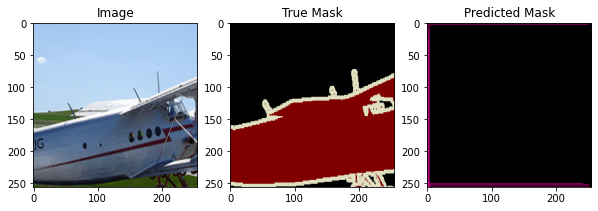

Epoch 33/100
1/1 [==============================] - 1s 605ms/step - loss: 1.2823 - accuracy: 0.0077 - val_loss: 4.8776 - val_accuracy: 0.0077


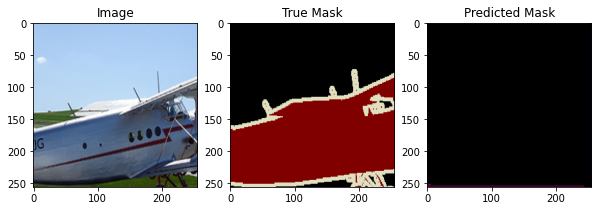

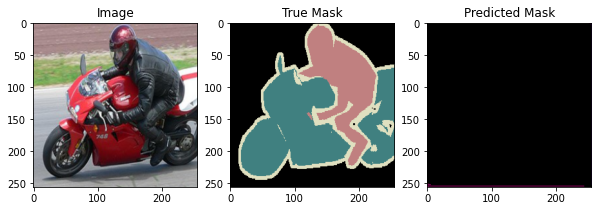

Epoch 34/100
1/1 [==============================] - 1s 605ms/step - loss: 1.2712 - accuracy: 0.0077 - val_loss: 5.7517 - val_accuracy: 0.0038


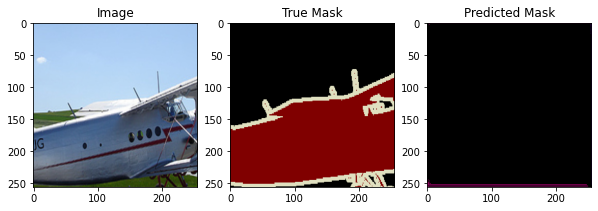

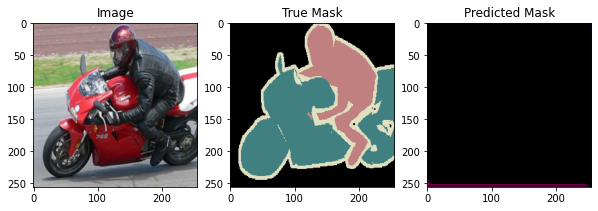

Epoch 35/100
1/1 [==============================] - 0s 470ms/step - loss: 1.2367 - accuracy: 0.0038 - val_loss: 6.9799 - val_accuracy: 0.0039


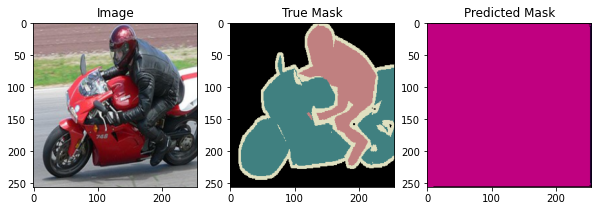

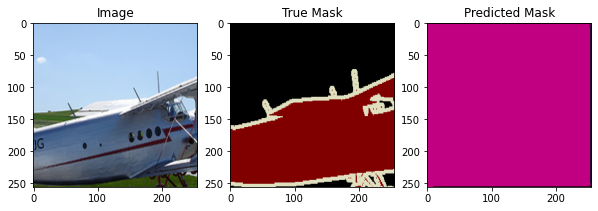

Epoch 36/100
1/1 [==============================] - 0s 468ms/step - loss: 1.2274 - accuracy: 0.0039 - val_loss: 7.7027 - val_accuracy: 0.0039


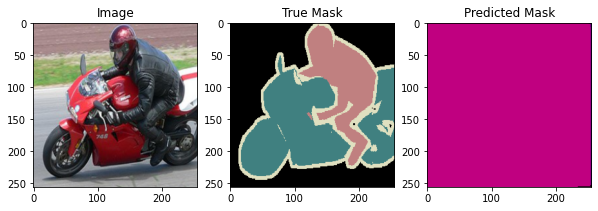

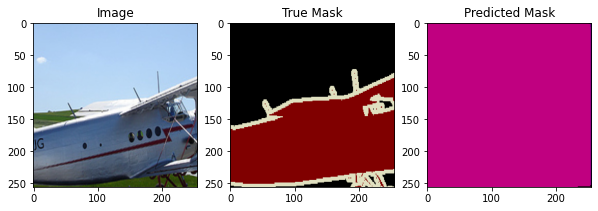

Epoch 37/100
1/1 [==============================] - 0s 487ms/step - loss: 1.2649 - accuracy: 0.0039 - val_loss: 7.2936 - val_accuracy: 0.0039


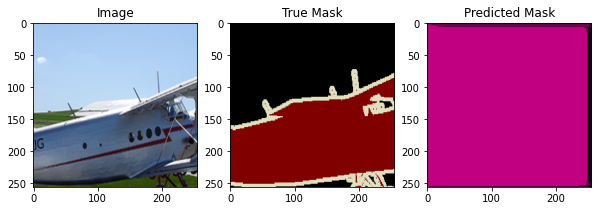

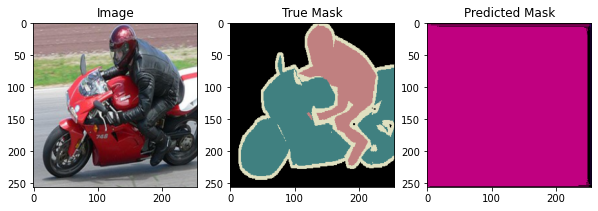

Epoch 38/100
1/1 [==============================] - 1s 603ms/step - loss: 1.2241 - accuracy: 0.0039 - val_loss: 6.9297 - val_accuracy: 0.0039


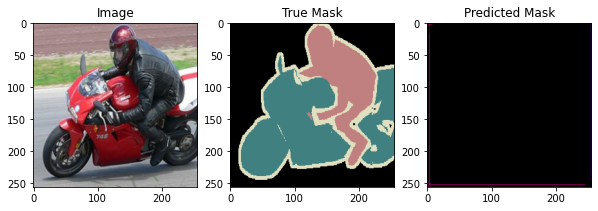

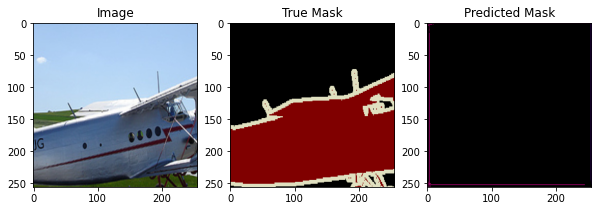

Epoch 39/100
1/1 [==============================] - 0s 478ms/step - loss: 1.2291 - accuracy: 0.0039 - val_loss: 6.7440 - val_accuracy: 0.0077


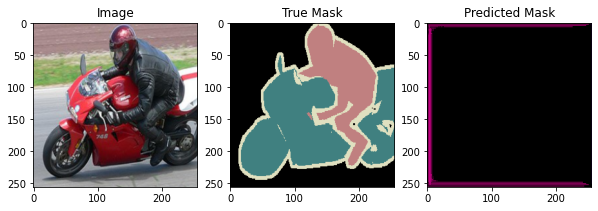

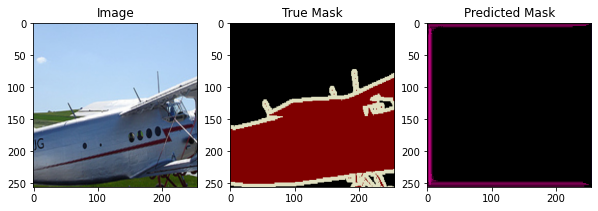

Epoch 40/100
1/1 [==============================] - 0s 359ms/step - loss: 1.2203 - accuracy: 0.0077 - val_loss: 6.8165 - val_accuracy: 0.0078


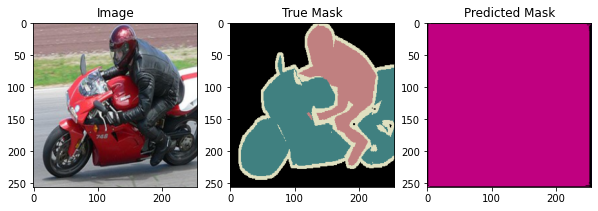

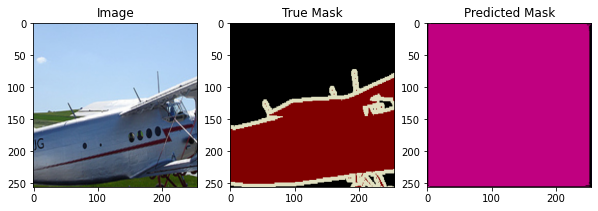

Epoch 41/100
1/1 [==============================] - 0s 491ms/step - loss: 1.2374 - accuracy: 0.0078 - val_loss: 6.8586 - val_accuracy: 0.0076


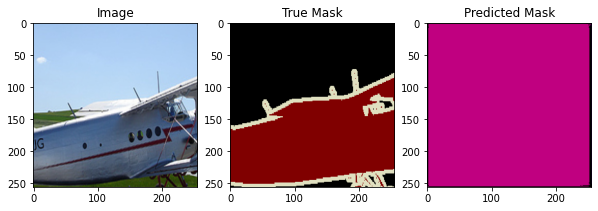

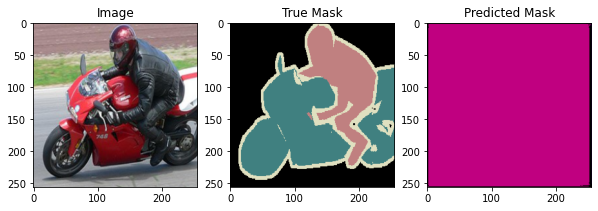

Epoch 42/100
1/1 [==============================] - 1s 745ms/step - loss: 1.2166 - accuracy: 0.0076 - val_loss: 6.8982 - val_accuracy: 0.0038


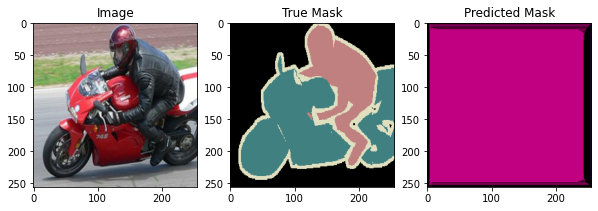

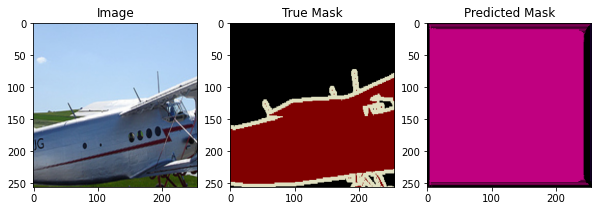

Epoch 43/100
1/1 [==============================] - 0s 336ms/step - loss: 1.2050 - accuracy: 0.0038 - val_loss: 7.0135 - val_accuracy: 0.0038


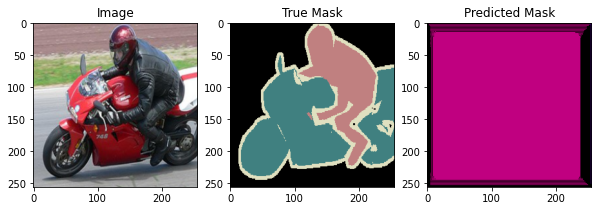

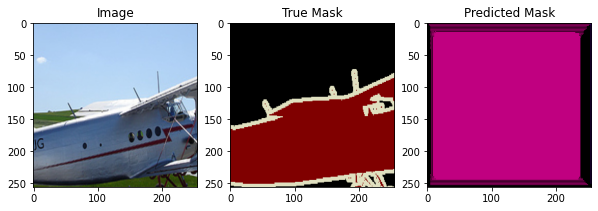

Epoch 44/100
1/1 [==============================] - 0s 495ms/step - loss: 1.2167 - accuracy: 0.0038 - val_loss: 7.0792 - val_accuracy: 0.0000e+00


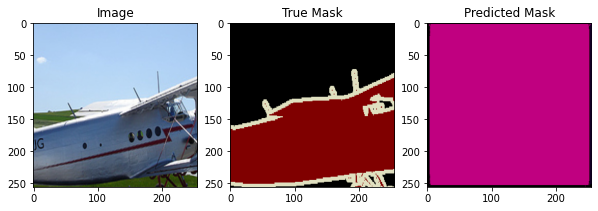

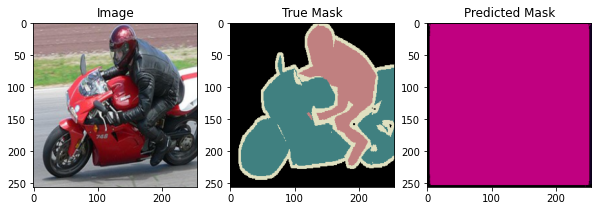

Epoch 45/100
1/1 [==============================] - 1s 606ms/step - loss: 1.2150 - accuracy: 0.0000e+00 - val_loss: 7.0056 - val_accuracy: 3.0518e-05


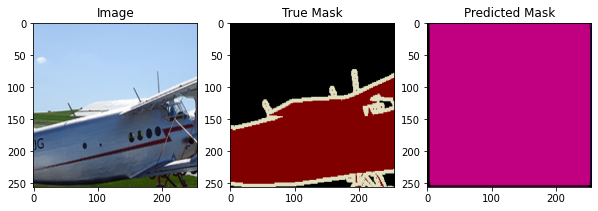

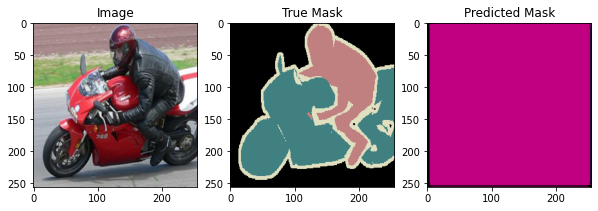

Epoch 46/100
1/1 [==============================] - 0s 481ms/step - loss: 1.2128 - accuracy: 3.0518e-05 - val_loss: 6.5818 - val_accuracy: 0.0000e+00


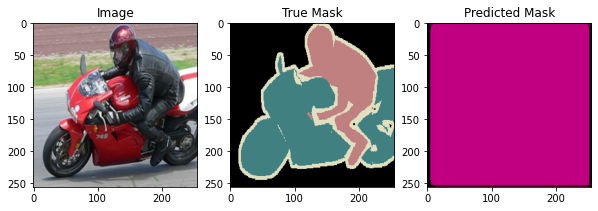

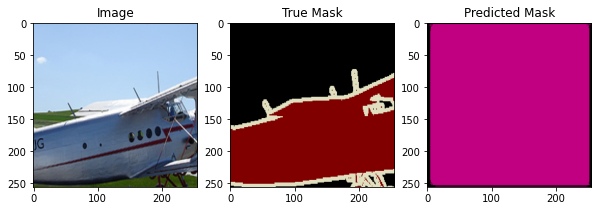

Epoch 47/100
1/1 [==============================] - 1s 579ms/step - loss: 1.2002 - accuracy: 0.0000e+00 - val_loss: 6.1357 - val_accuracy: 1.5259e-05


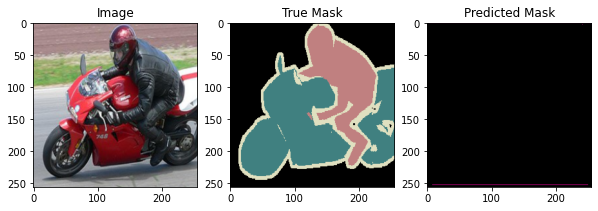

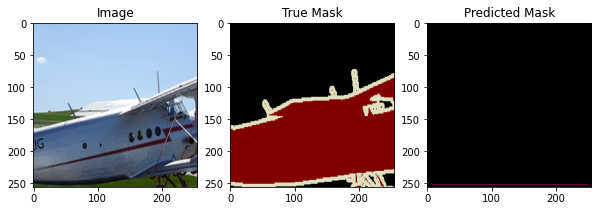

Epoch 48/100
1/1 [==============================] - 1s 545ms/step - loss: 1.2177 - accuracy: 1.5259e-05 - val_loss: 6.1212 - val_accuracy: 0.0038


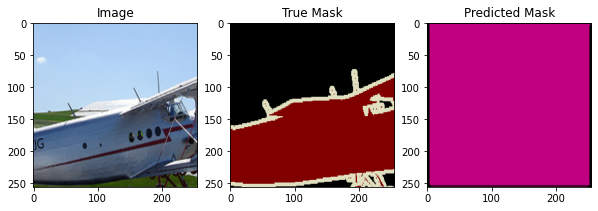

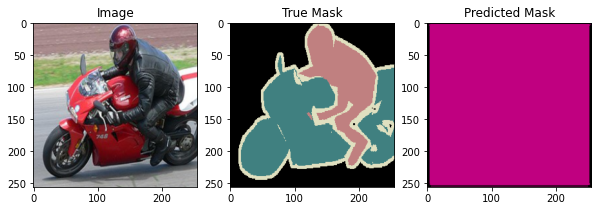

Epoch 49/100
1/1 [==============================] - 0s 493ms/step - loss: 1.2114 - accuracy: 0.0038 - val_loss: 6.1800 - val_accuracy: 0.0038


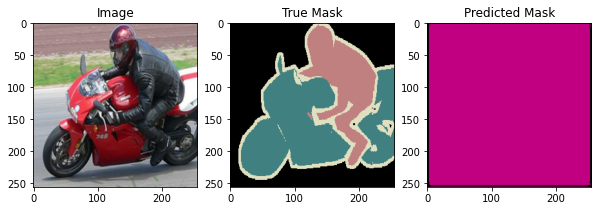

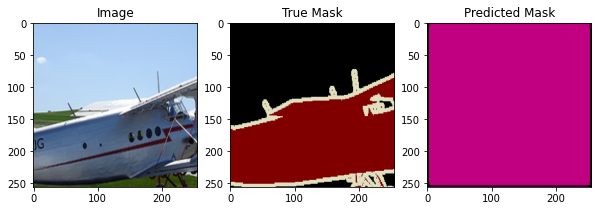

Epoch 50/100
1/1 [==============================] - 0s 473ms/step - loss: 1.2151 - accuracy: 0.0038 - val_loss: 6.2364 - val_accuracy: 0.0036


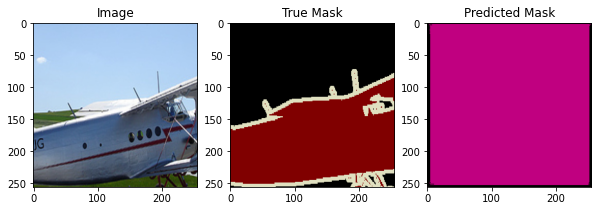

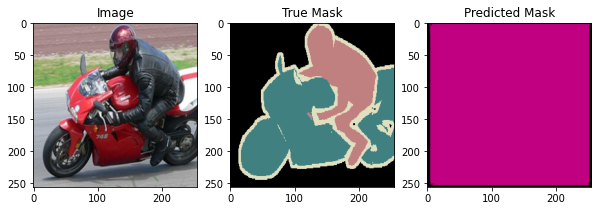

Epoch 51/100
1/1 [==============================] - 1s 637ms/step - loss: 1.2016 - accuracy: 0.0036 - val_loss: 6.3798 - val_accuracy: 0.0000e+00


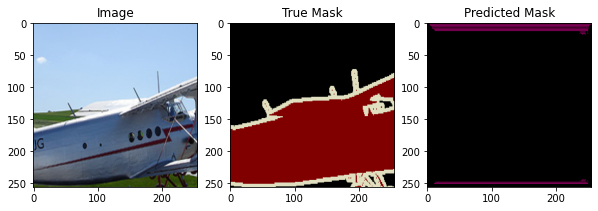

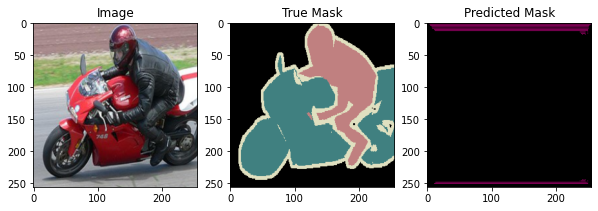

Epoch 52/100
1/1 [==============================] - 0s 339ms/step - loss: 1.2049 - accuracy: 0.0000e+00 - val_loss: 6.5633 - val_accuracy: 0.0000e+00


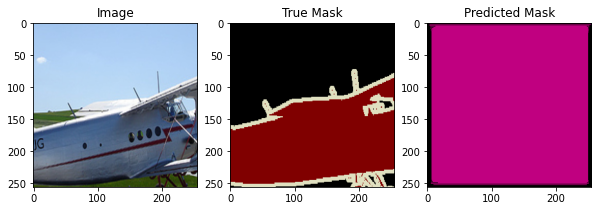

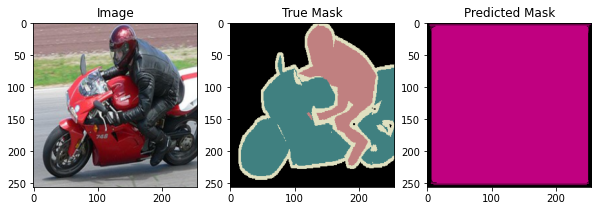

Epoch 53/100
1/1 [==============================] - 1s 643ms/step - loss: 1.2023 - accuracy: 0.0000e+00 - val_loss: 6.7263 - val_accuracy: 0.0000e+00


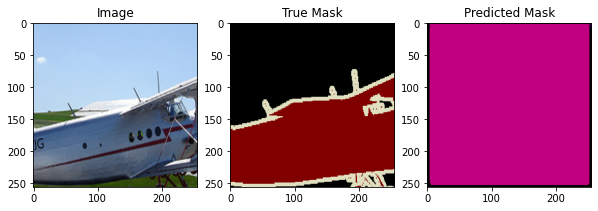

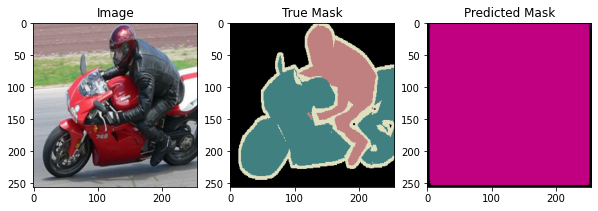

Epoch 54/100
1/1 [==============================] - 1s 594ms/step - loss: 1.2025 - accuracy: 0.0000e+00 - val_loss: 6.7588 - val_accuracy: 0.0000e+00


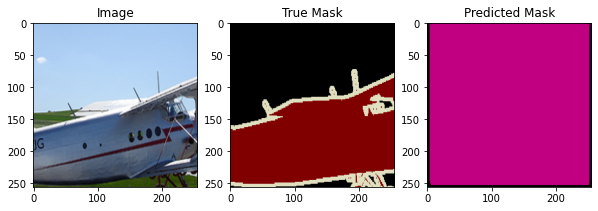

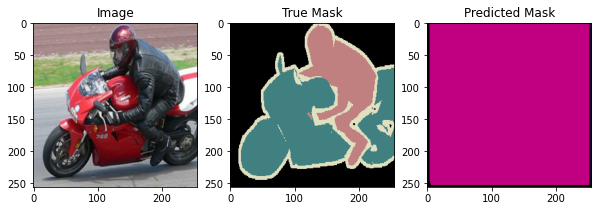

Epoch 55/100
1/1 [==============================] - 0s 346ms/step - loss: 1.2008 - accuracy: 0.0000e+00 - val_loss: 6.7161 - val_accuracy: 0.0000e+00


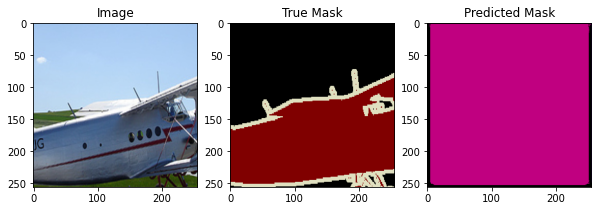

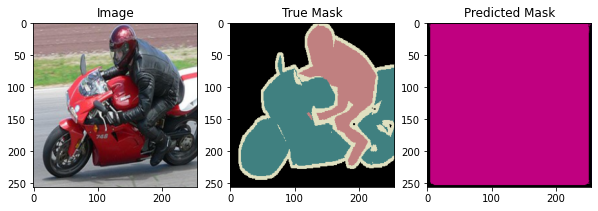

Epoch 56/100
1/1 [==============================] - 0s 480ms/step - loss: 1.1964 - accuracy: 0.0000e+00 - val_loss: 6.6506 - val_accuracy: 0.0000e+00


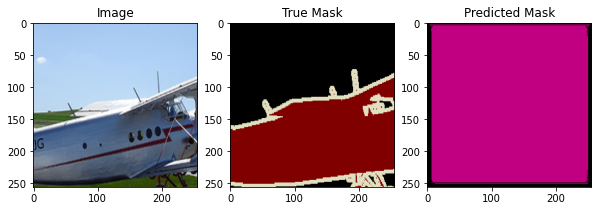

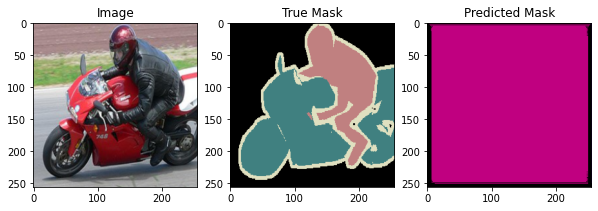

Epoch 57/100
1/1 [==============================] - 0s 473ms/step - loss: 1.1957 - accuracy: 0.0000e+00 - val_loss: 6.6192 - val_accuracy: 0.0000e+00


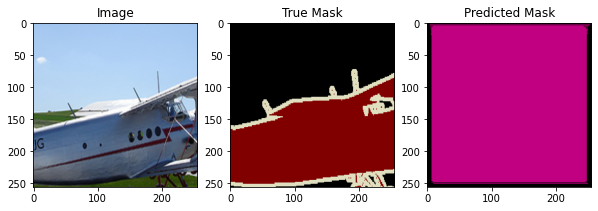

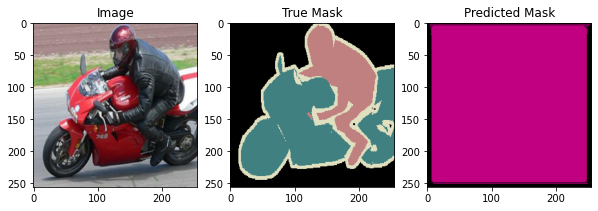

Epoch 58/100
1/1 [==============================] - 1s 612ms/step - loss: 1.1964 - accuracy: 0.0000e+00 - val_loss: 6.7351 - val_accuracy: 0.0000e+00


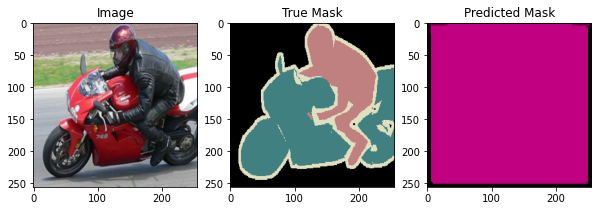

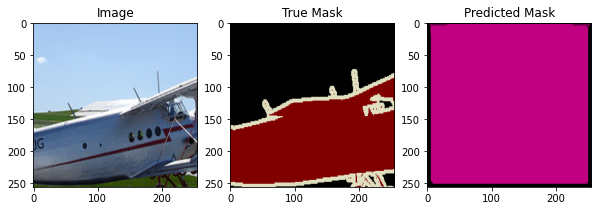

Epoch 59/100
1/1 [==============================] - 1s 522ms/step - loss: 1.1961 - accuracy: 0.0000e+00 - val_loss: 7.0406 - val_accuracy: 0.0000e+00


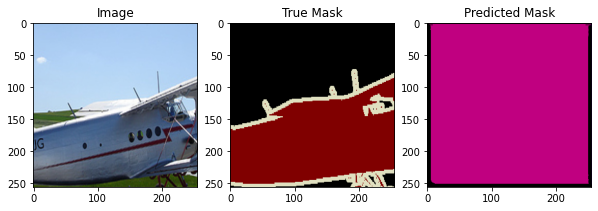

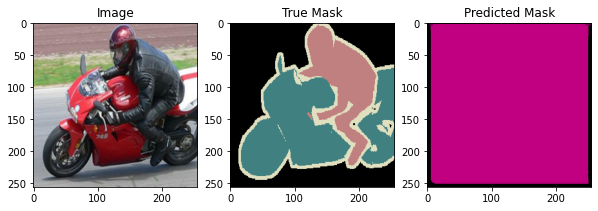

Epoch 60/100
1/1 [==============================] - 1s 603ms/step - loss: 1.1924 - accuracy: 0.0000e+00 - val_loss: 7.4618 - val_accuracy: 0.0000e+00


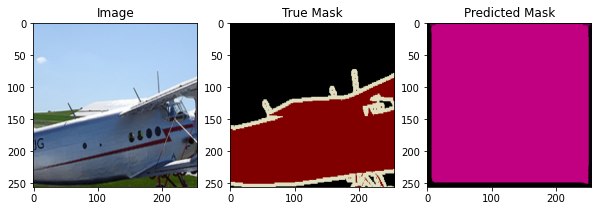

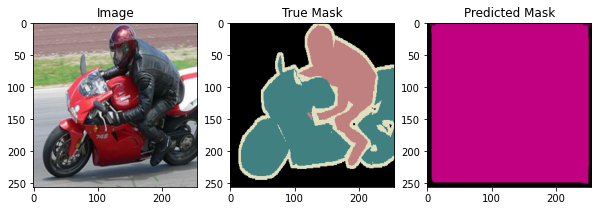

Epoch 61/100
1/1 [==============================] - 1s 607ms/step - loss: 1.1938 - accuracy: 0.0000e+00 - val_loss: 7.6929 - val_accuracy: 0.0000e+00


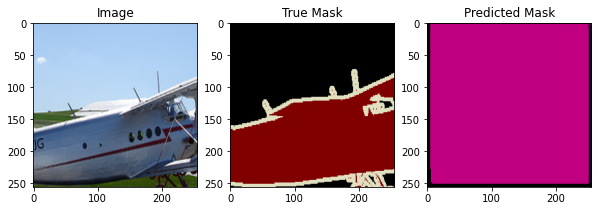

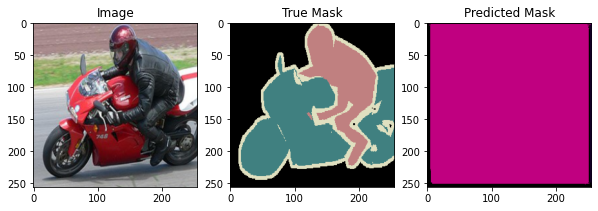

Epoch 62/100
1/1 [==============================] - 1s 600ms/step - loss: 1.1932 - accuracy: 0.0000e+00 - val_loss: 7.9879 - val_accuracy: 0.0000e+00


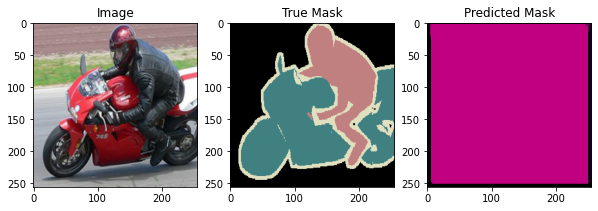

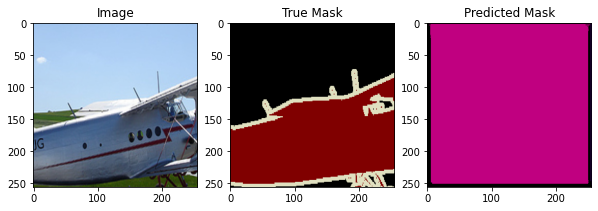

Epoch 63/100
1/1 [==============================] - 1s 592ms/step - loss: 1.1923 - accuracy: 0.0000e+00 - val_loss: 8.3176 - val_accuracy: 0.0000e+00


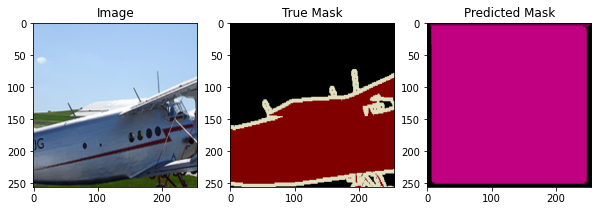

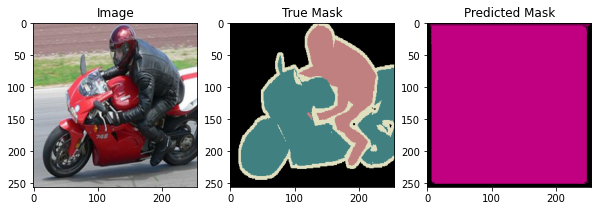

Epoch 64/100
1/1 [==============================] - 1s 605ms/step - loss: 1.1908 - accuracy: 0.0000e+00 - val_loss: 8.4311 - val_accuracy: 0.0000e+00


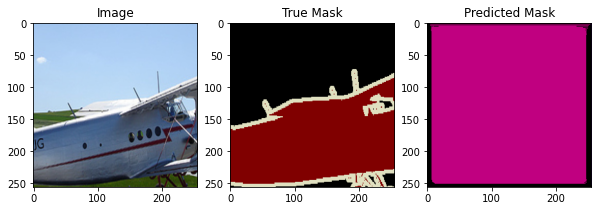

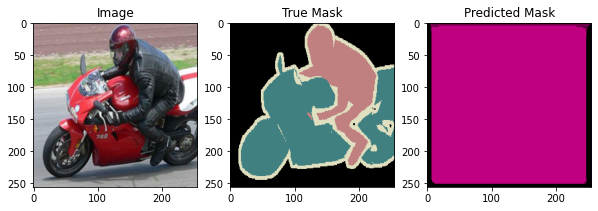

Epoch 65/100
1/1 [==============================] - 1s 590ms/step - loss: 1.1888 - accuracy: 0.0000e+00 - val_loss: 8.4929 - val_accuracy: 0.0000e+00


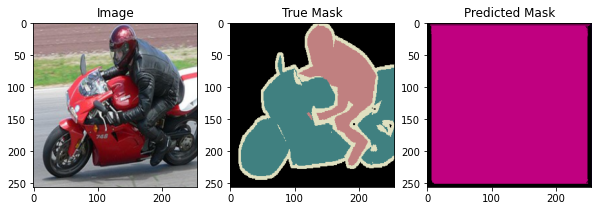

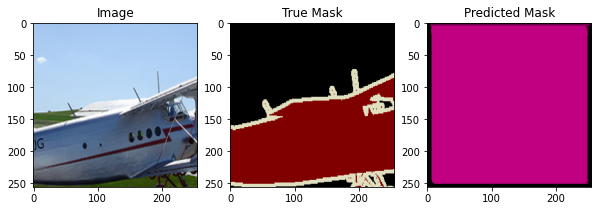

Epoch 66/100
1/1 [==============================] - 1s 513ms/step - loss: 1.1882 - accuracy: 0.0000e+00 - val_loss: 8.8080 - val_accuracy: 0.0000e+00


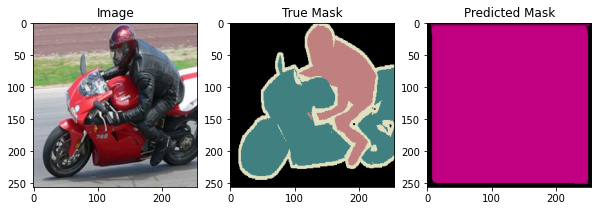

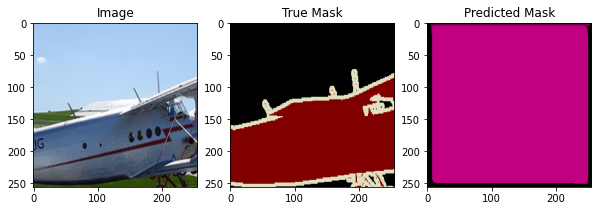

Epoch 67/100
1/1 [==============================] - 1s 603ms/step - loss: 1.1862 - accuracy: 0.0000e+00 - val_loss: 9.4081 - val_accuracy: 0.0000e+00


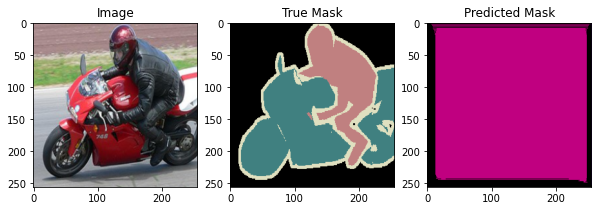

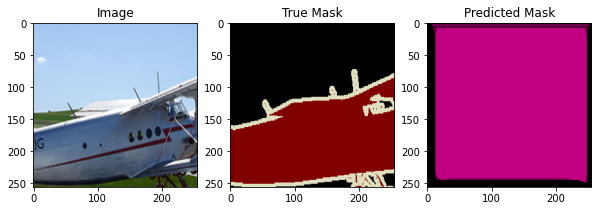

Epoch 68/100
1/1 [==============================] - 1s 596ms/step - loss: 1.2012 - accuracy: 0.0000e+00 - val_loss: 9.2491 - val_accuracy: 0.0000e+00


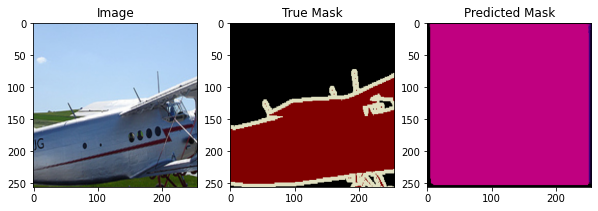

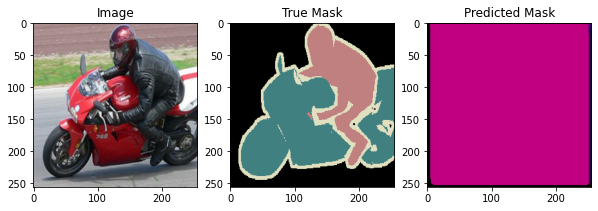

Epoch 69/100
1/1 [==============================] - 0s 477ms/step - loss: 1.2175 - accuracy: 0.0000e+00 - val_loss: 9.3093 - val_accuracy: 0.0000e+00


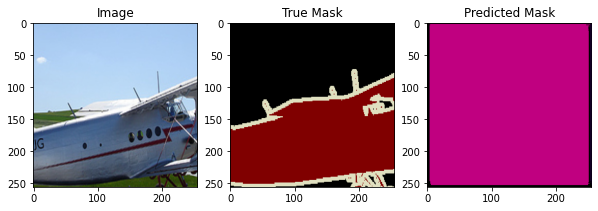

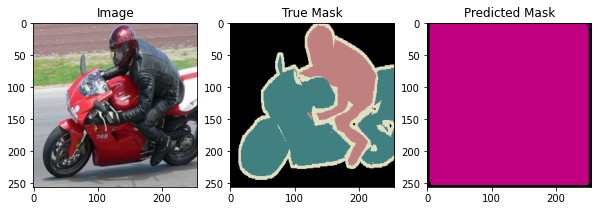

Epoch 70/100
1/1 [==============================] - 1s 598ms/step - loss: 1.1944 - accuracy: 0.0000e+00 - val_loss: 9.4767 - val_accuracy: 0.0000e+00


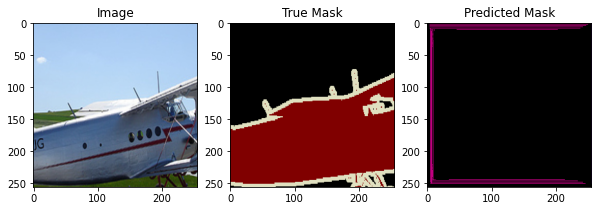

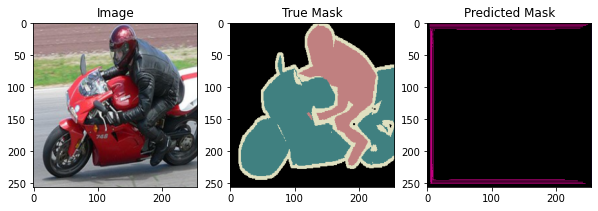

Epoch 71/100
1/1 [==============================] - 1s 610ms/step - loss: 1.2047 - accuracy: 0.0000e+00 - val_loss: 9.2388 - val_accuracy: 0.0000e+00


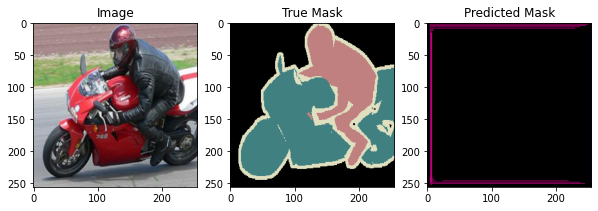

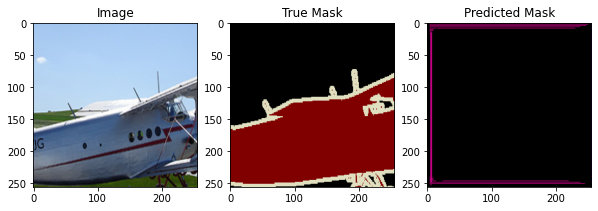

Epoch 72/100
1/1 [==============================] - 0s 341ms/step - loss: 1.2047 - accuracy: 0.0000e+00 - val_loss: 8.7722 - val_accuracy: 0.0000e+00


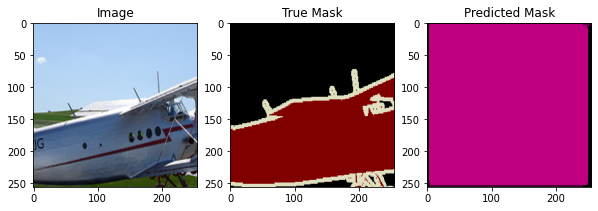

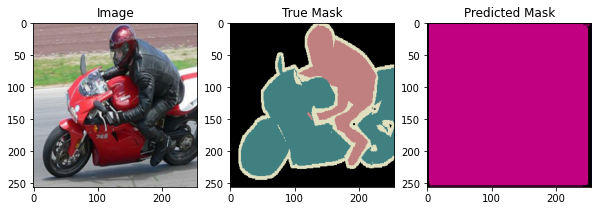

Epoch 73/100
1/1 [==============================] - 1s 613ms/step - loss: 1.1929 - accuracy: 0.0000e+00 - val_loss: 8.5125 - val_accuracy: 0.0000e+00


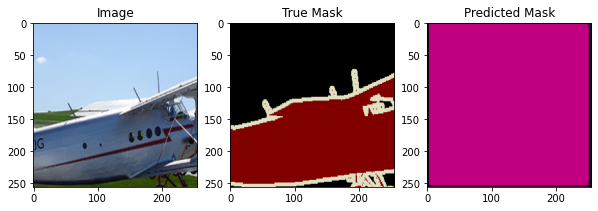

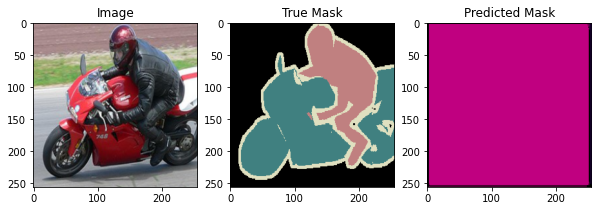

Epoch 74/100
1/1 [==============================] - 1s 599ms/step - loss: 1.2069 - accuracy: 0.0000e+00 - val_loss: 8.4527 - val_accuracy: 0.0000e+00


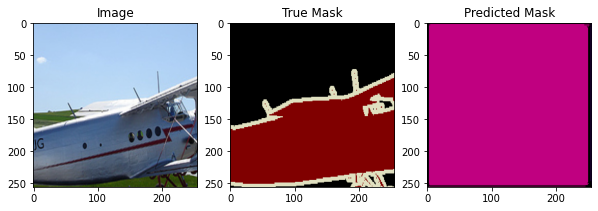

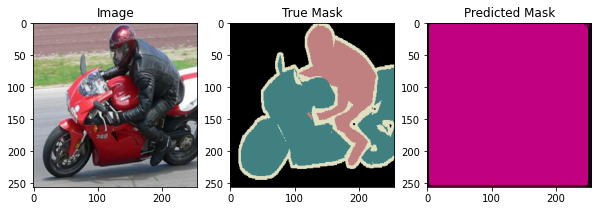

Epoch 75/100
1/1 [==============================] - 1s 601ms/step - loss: 1.1953 - accuracy: 0.0000e+00 - val_loss: 8.5639 - val_accuracy: 0.0000e+00


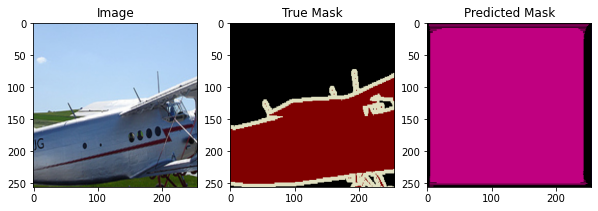

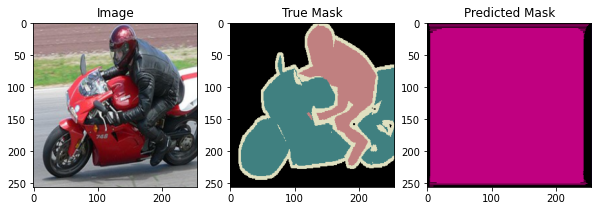

Epoch 76/100
1/1 [==============================] - 1s 643ms/step - loss: 1.1939 - accuracy: 0.0000e+00 - val_loss: 8.5326 - val_accuracy: 0.0000e+00


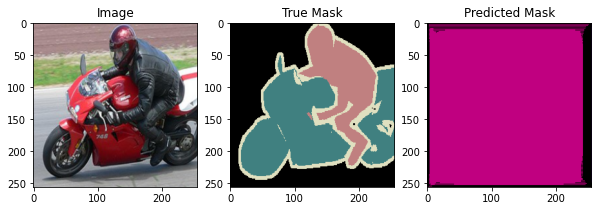

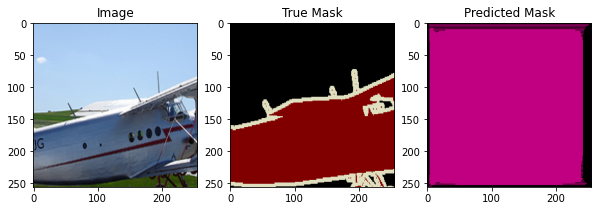

Epoch 77/100
1/1 [==============================] - 1s 619ms/step - loss: 1.2004 - accuracy: 0.0000e+00 - val_loss: 8.1861 - val_accuracy: 0.0000e+00


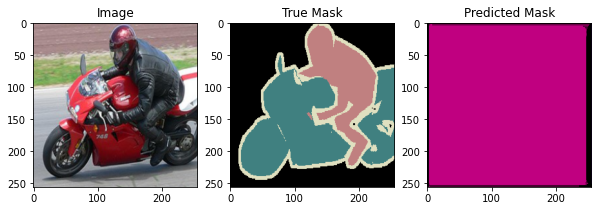

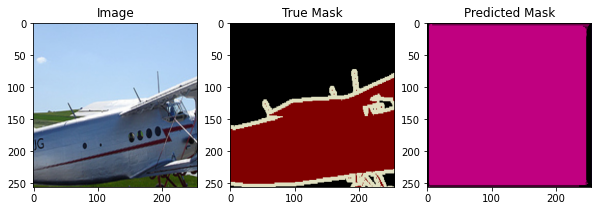

Epoch 78/100
1/1 [==============================] - 1s 602ms/step - loss: 1.1922 - accuracy: 0.0000e+00 - val_loss: 7.8367 - val_accuracy: 0.0000e+00


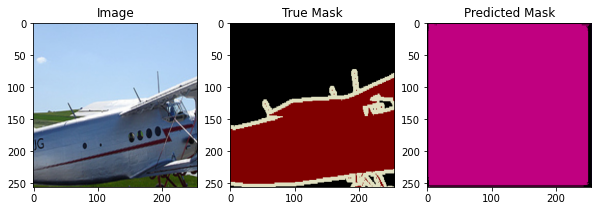

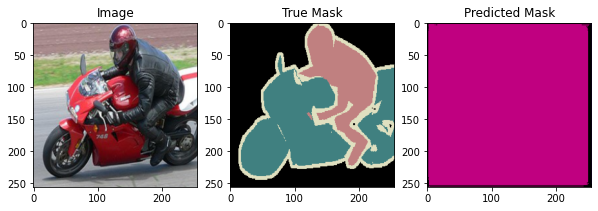

Epoch 79/100
1/1 [==============================] - 1s 596ms/step - loss: 1.1946 - accuracy: 0.0000e+00 - val_loss: 7.7542 - val_accuracy: 0.0000e+00


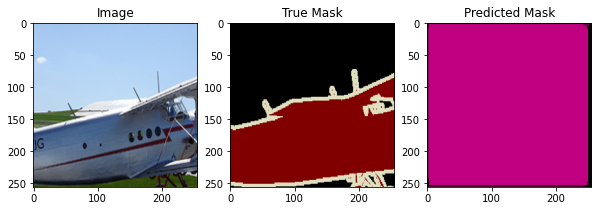

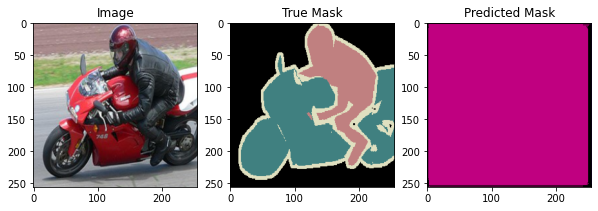

Epoch 80/100
1/1 [==============================] - 1s 603ms/step - loss: 1.1970 - accuracy: 0.0000e+00 - val_loss: 7.9858 - val_accuracy: 0.0000e+00


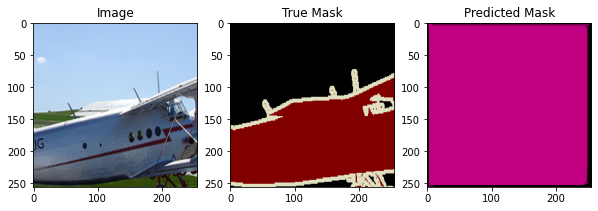

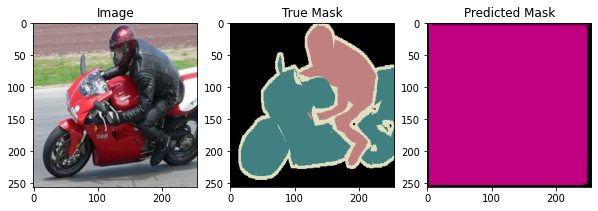

Epoch 81/100
1/1 [==============================] - 0s 470ms/step - loss: 1.1902 - accuracy: 0.0000e+00 - val_loss: 8.4166 - val_accuracy: 0.0000e+00


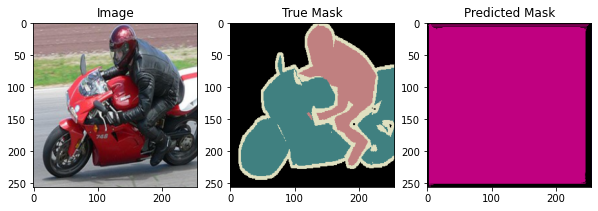

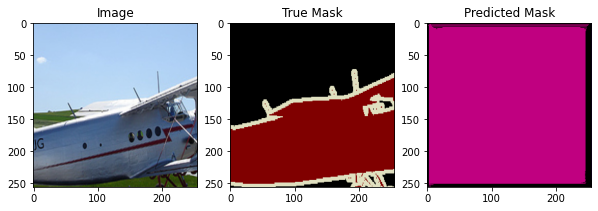

Epoch 82/100
1/1 [==============================] - 0s 480ms/step - loss: 1.1919 - accuracy: 0.0000e+00 - val_loss: 8.4557 - val_accuracy: 0.0000e+00


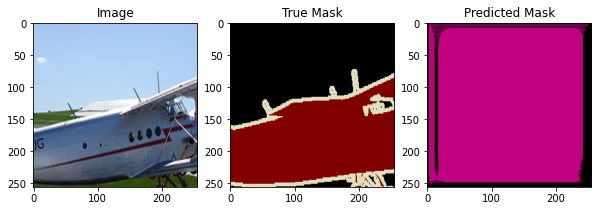

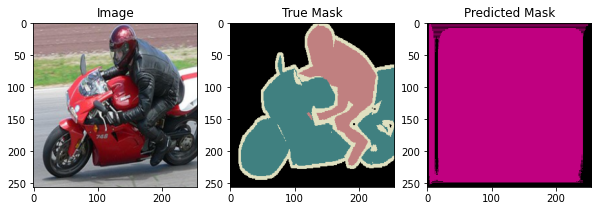

Epoch 83/100
1/1 [==============================] - 1s 611ms/step - loss: 1.1932 - accuracy: 0.0000e+00 - val_loss: 7.9813 - val_accuracy: 0.0000e+00


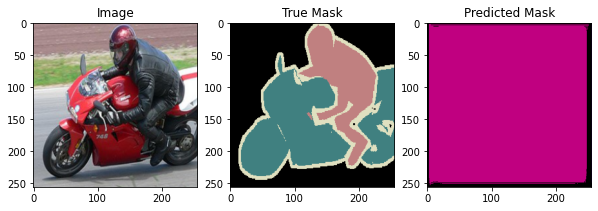

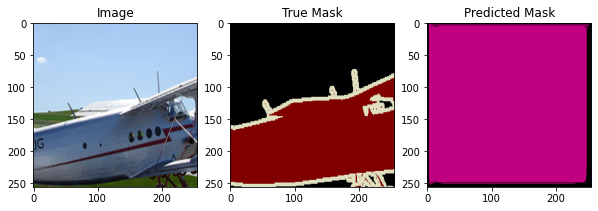

Epoch 84/100
1/1 [==============================] - 1s 593ms/step - loss: 1.1855 - accuracy: 0.0000e+00 - val_loss: 7.8483 - val_accuracy: 0.0000e+00


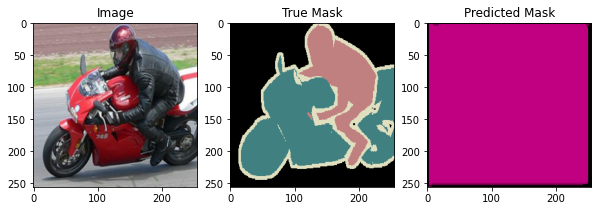

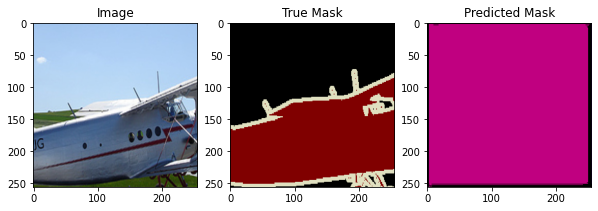

Epoch 85/100
1/1 [==============================] - 0s 440ms/step - loss: 1.1894 - accuracy: 0.0000e+00 - val_loss: 8.1350 - val_accuracy: 0.0000e+00


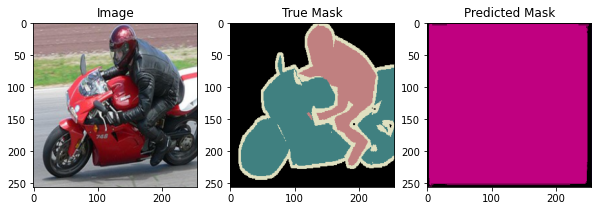

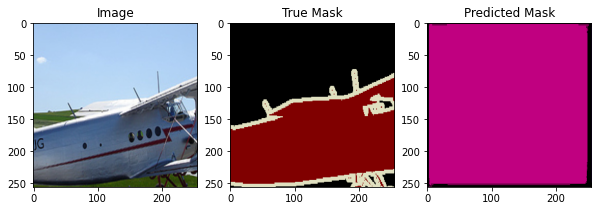

Epoch 86/100
1/1 [==============================] - 0s 470ms/step - loss: 1.1828 - accuracy: 0.0000e+00 - val_loss: 8.7383 - val_accuracy: 0.0000e+00


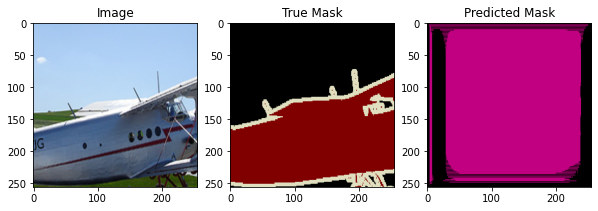

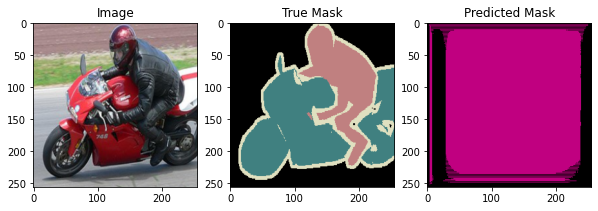

Epoch 87/100
1/1 [==============================] - 0s 466ms/step - loss: 1.1844 - accuracy: 0.0000e+00 - val_loss: 8.6546 - val_accuracy: 0.0000e+00


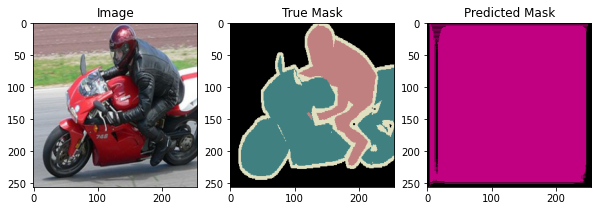

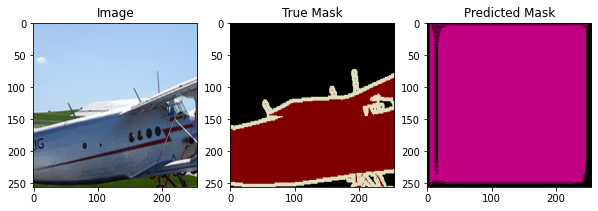

Epoch 88/100
1/1 [==============================] - 1s 598ms/step - loss: 1.1776 - accuracy: 0.0000e+00 - val_loss: 8.4067 - val_accuracy: 0.0000e+00


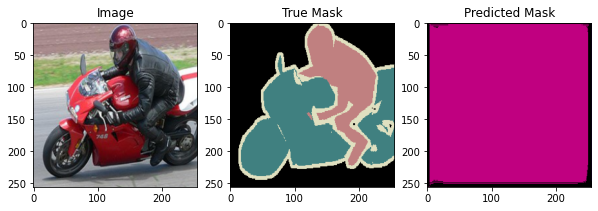

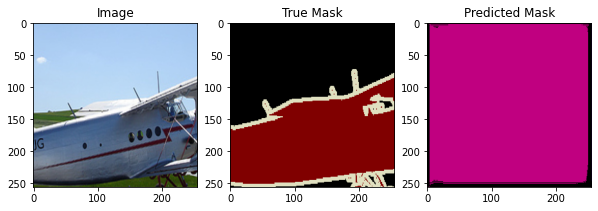

Epoch 89/100
1/1 [==============================] - 1s 597ms/step - loss: 1.1749 - accuracy: 0.0000e+00 - val_loss: 8.9555 - val_accuracy: 0.0000e+00


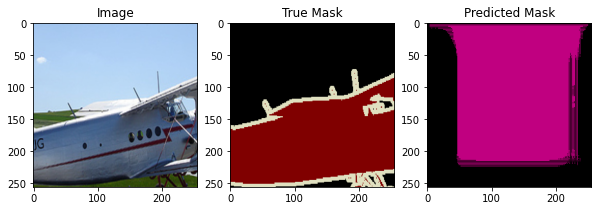

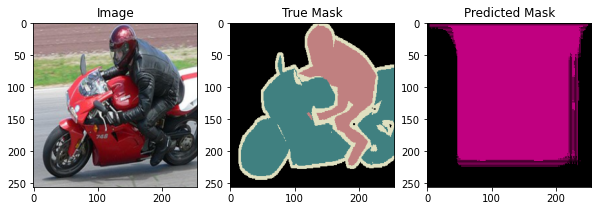

Epoch 90/100
1/1 [==============================] - 1s 596ms/step - loss: 1.1718 - accuracy: 0.0000e+00 - val_loss: 9.2180 - val_accuracy: 0.0000e+00


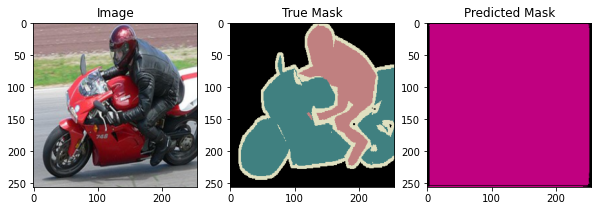

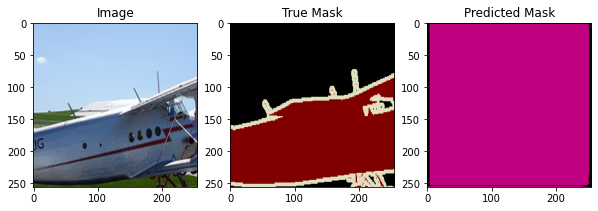

Epoch 91/100
1/1 [==============================] - 0s 352ms/step - loss: 1.1872 - accuracy: 0.0000e+00 - val_loss: 8.7342 - val_accuracy: 0.0000e+00


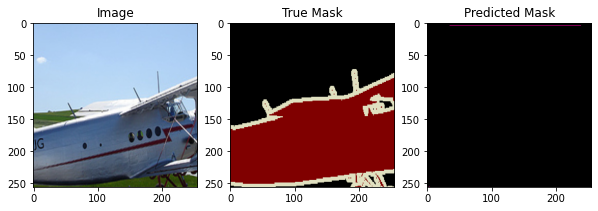

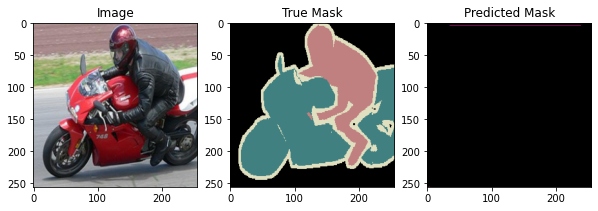

Epoch 92/100
1/1 [==============================] - 1s 601ms/step - loss: 1.1687 - accuracy: 0.0000e+00 - val_loss: 8.7583 - val_accuracy: 0.0000e+00


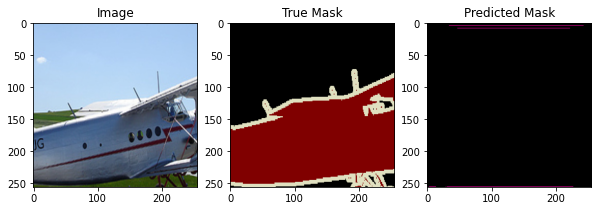

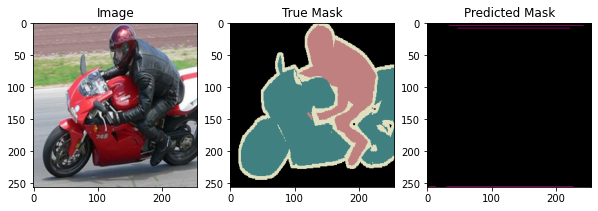

Epoch 93/100
1/1 [==============================] - 0s 332ms/step - loss: 1.1618 - accuracy: 0.0000e+00 - val_loss: 8.7724 - val_accuracy: 0.0000e+00


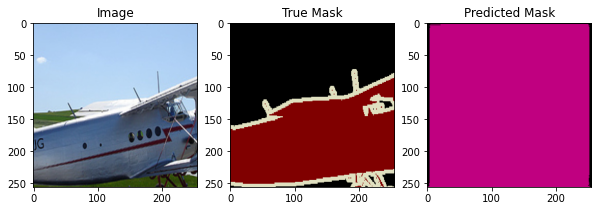

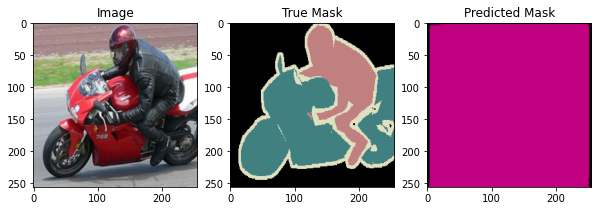

Epoch 94/100
1/1 [==============================] - 1s 583ms/step - loss: 1.1782 - accuracy: 0.0000e+00 - val_loss: 8.5152 - val_accuracy: 0.0000e+00


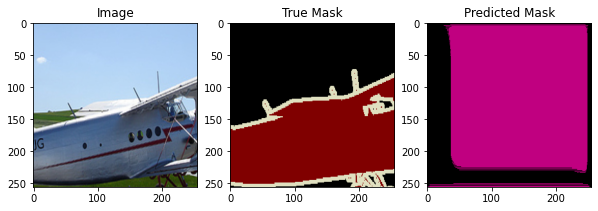

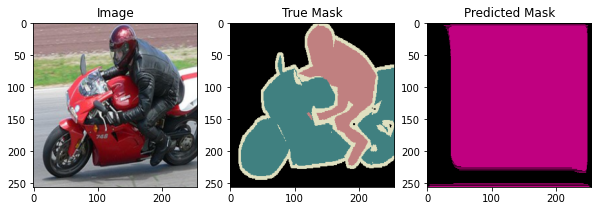

Epoch 95/100
1/1 [==============================] - 1s 595ms/step - loss: 1.1435 - accuracy: 0.0000e+00 - val_loss: 9.7732 - val_accuracy: 0.0000e+00


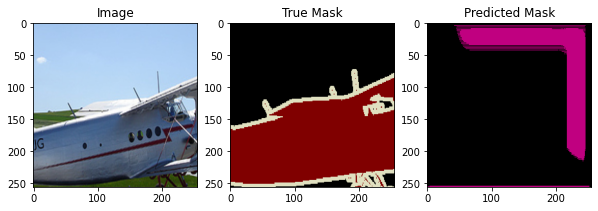

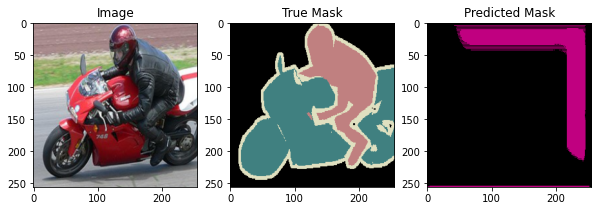

Epoch 96/100
1/1 [==============================] - 0s 468ms/step - loss: 1.1848 - accuracy: 0.0000e+00 - val_loss: 8.4635 - val_accuracy: 0.0000e+00


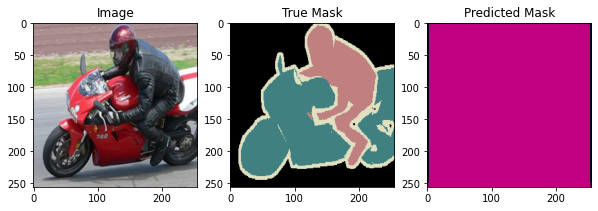

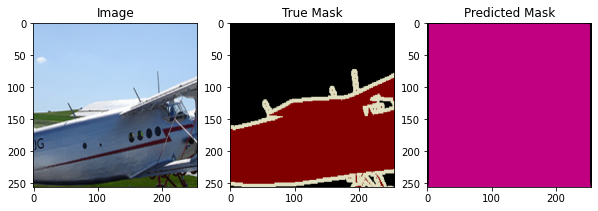

Epoch 97/100
1/1 [==============================] - 0s 480ms/step - loss: 1.2734 - accuracy: 0.0000e+00 - val_loss: 7.1153 - val_accuracy: 0.0000e+00


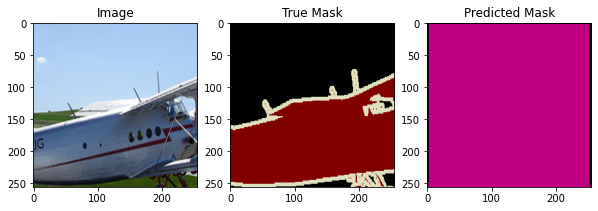

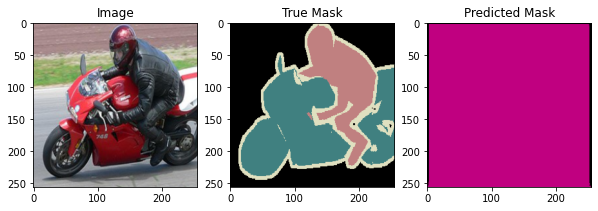

Epoch 98/100
1/1 [==============================] - 0s 351ms/step - loss: 1.2353 - accuracy: 0.0000e+00 - val_loss: 6.3479 - val_accuracy: 0.0000e+00


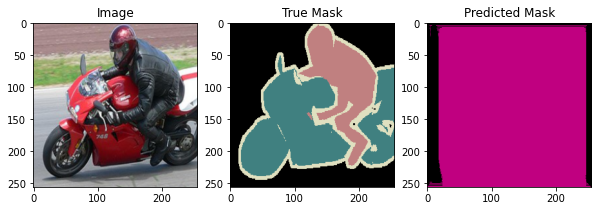

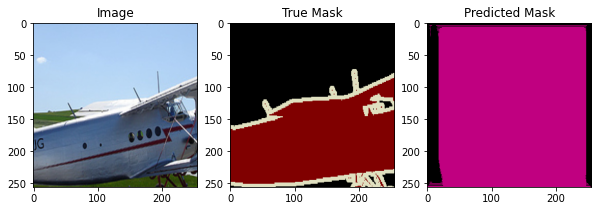

Epoch 99/100
1/1 [==============================] - 1s 542ms/step - loss: 1.2049 - accuracy: 0.0000e+00 - val_loss: 6.4650 - val_accuracy: 0.0000e+00


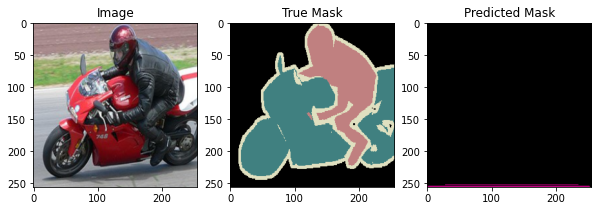

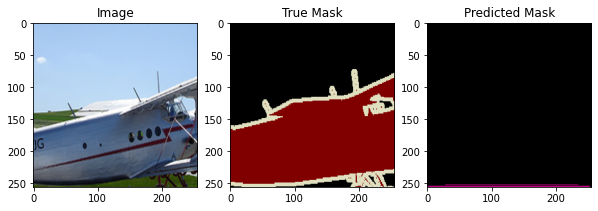

Epoch 100/100
1/1 [==============================] - 1s 609ms/step - loss: 1.2035 - accuracy: 0.0000e+00 - val_loss: 6.4754 - val_accuracy: 0.0000e+00


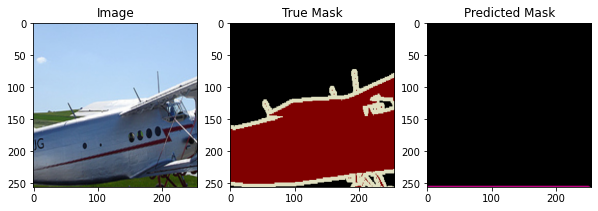

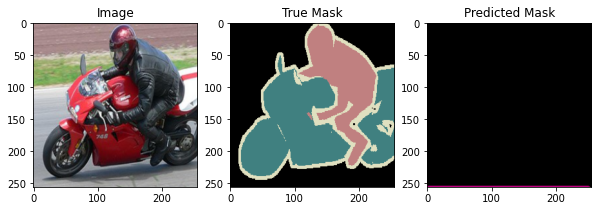

In [27]:
train_generator = PascalVOCDataGenerator(train_data, batch_size=32)
val_generator = PascalVOCDataGenerator(val_data, batch_size=32)

from tensorflow.keras.callbacks import TensorBoard

log_dir = "./logs"  # 로그 파일이 저장될 디렉토리 지정
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)


from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint_filepath = './best_model.h5'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=False,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)


from tensorflow.keras.callbacks import Callback

class VisualizationCallback(Callback):
    def __init__(self, val_data):
        super().__init__()
        self.val_data = val_data
        # Get the number of samples in the first batch of val_data
        self.num_samples = len(next(iter(val_data))[0])

    def on_epoch_end(self, epoch, logs=None):
        # Get a batch from the validation data
        images, masks = next(iter(self.val_data))
        
        # Predict masks
        predicted_masks = self.model.predict(images[:self.num_samples])
        predicted_masks = np.argmax(predicted_masks, axis=-1)[..., np.newaxis]

        for i in range(self.num_samples):
            plt.figure(figsize=(10, 4))
            image = images[i] * 255

            plt.subplot(1, 3, 1)
            plt.imshow(image)
            plt.title("Image")

            plt.subplot(1, 3, 2)
            plt.imshow(decode_mask(np.squeeze(masks[i], axis=-1)))
            plt.title("True Mask")

            plt.subplot(1, 3, 3)
            plt.imshow(decode_mask(np.squeeze(predicted_masks[i], axis=-1)))
            plt.title("Predicted Mask")

            plt.show()

visualization_callback = VisualizationCallback(val_generator)
# model: without regularizer

history = model.fit(train_generator, 
                    validation_data=val_generator, 
                    epochs=100, 
                    callbacks=[tensorboard_callback, model_checkpoint_callback, visualization_callback])

Epoch 1/100
1/1 [==============================] - 2s 2s/step - loss: 3.0909 - accuracy: 0.0000e+00 - val_loss: 3.0890 - val_accuracy: 0.0000e+00


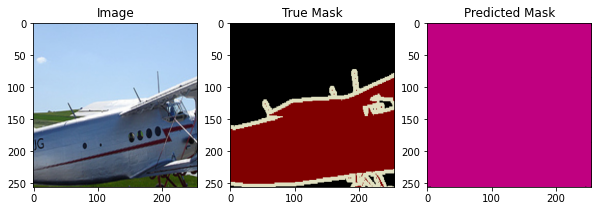

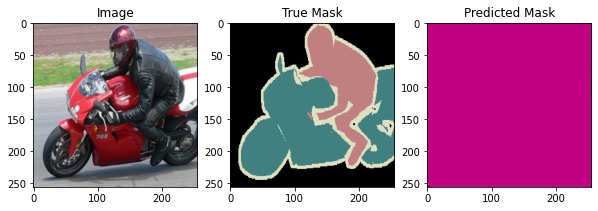

Epoch 2/100
1/1 [==============================] - 1s 724ms/step - loss: 3.0827 - accuracy: 0.0000e+00 - val_loss: 3.0811 - val_accuracy: 0.0000e+00


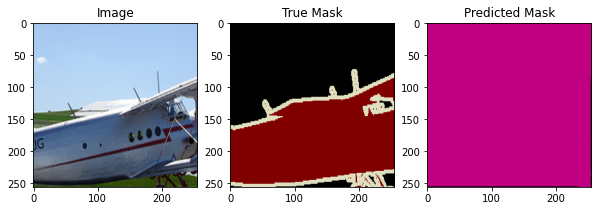

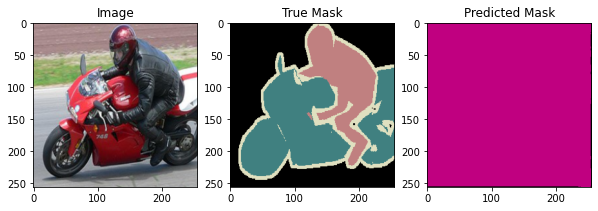

Epoch 3/100
1/1 [==============================] - 1s 619ms/step - loss: 3.0521 - accuracy: 0.0000e+00 - val_loss: 3.0163 - val_accuracy: 0.0000e+00


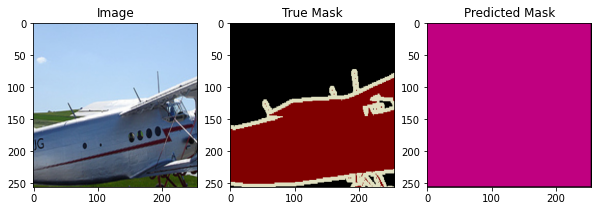

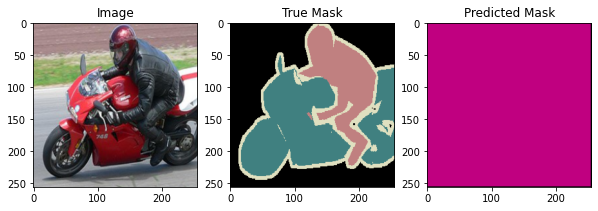

Epoch 4/100
1/1 [==============================] - 0s 471ms/step - loss: 2.5612 - accuracy: 0.0000e+00 - val_loss: 18.7886 - val_accuracy: 0.0000e+00


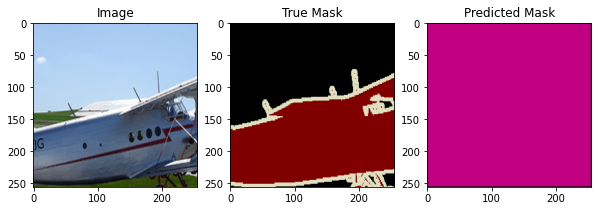

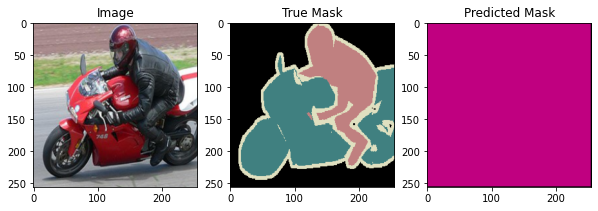

Epoch 5/100
1/1 [==============================] - 1s 502ms/step - loss: 6.6919 - accuracy: 0.0000e+00 - val_loss: 2.9299 - val_accuracy: 0.0000e+00


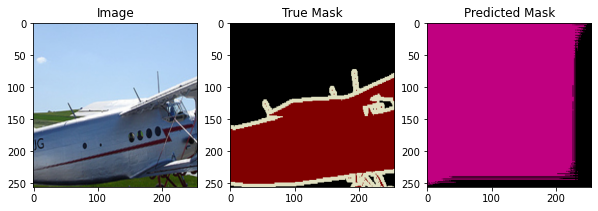

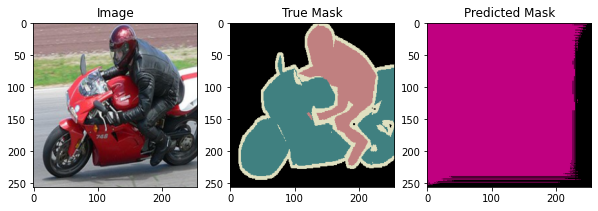

Epoch 6/100
1/1 [==============================] - 0s 493ms/step - loss: 2.0974 - accuracy: 0.0000e+00 - val_loss: 2.9459 - val_accuracy: 0.0000e+00


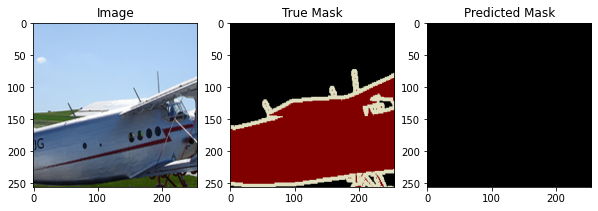

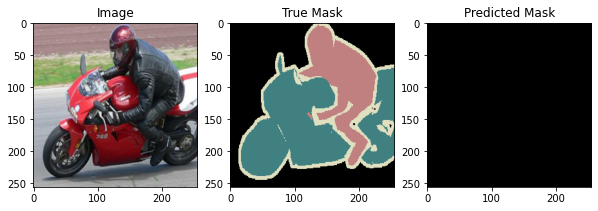

Epoch 7/100
1/1 [==============================] - 1s 630ms/step - loss: 2.7577 - accuracy: 0.0000e+00 - val_loss: 2.9851 - val_accuracy: 0.0000e+00


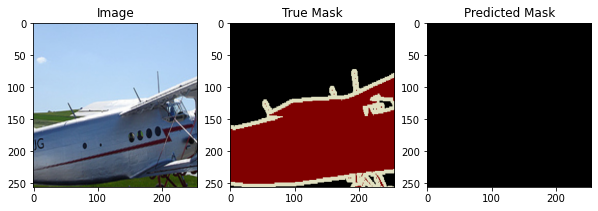

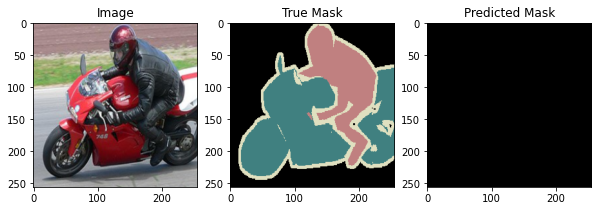

Epoch 8/100
1/1 [==============================] - 1s 577ms/step - loss: 2.8832 - accuracy: 0.0000e+00 - val_loss: 2.9856 - val_accuracy: 0.0000e+00


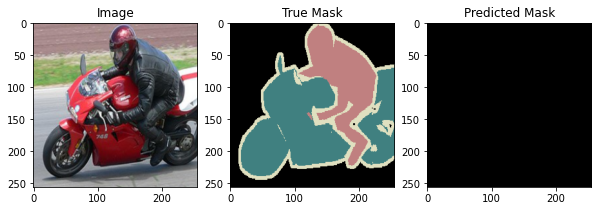

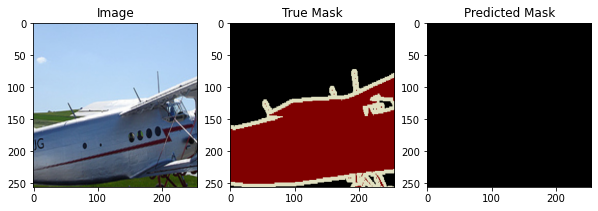

Epoch 9/100
1/1 [==============================] - 0s 475ms/step - loss: 2.8983 - accuracy: 0.0000e+00 - val_loss: 2.9702 - val_accuracy: 0.0000e+00


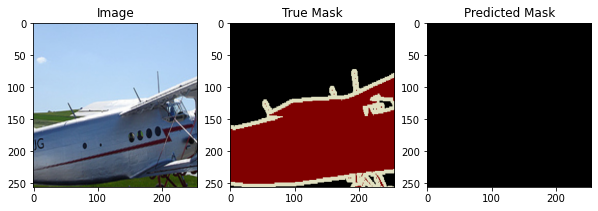

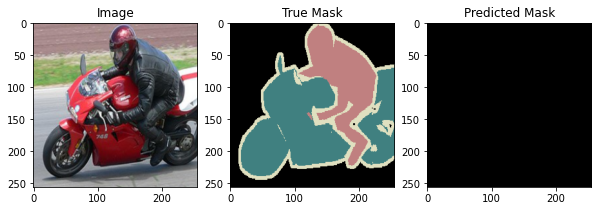

Epoch 10/100
1/1 [==============================] - 0s 479ms/step - loss: 2.8786 - accuracy: 0.0000e+00 - val_loss: 2.9392 - val_accuracy: 0.0000e+00


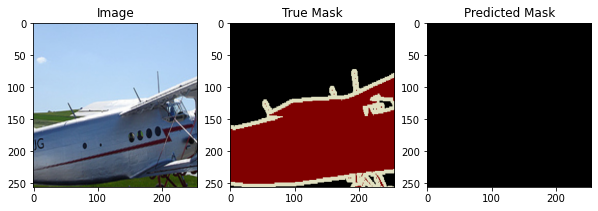

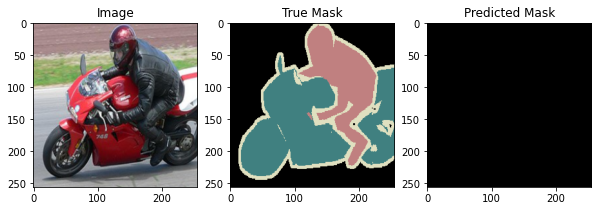

Epoch 11/100
1/1 [==============================] - 0s 479ms/step - loss: 2.8316 - accuracy: 0.0000e+00 - val_loss: 2.8832 - val_accuracy: 0.0000e+00


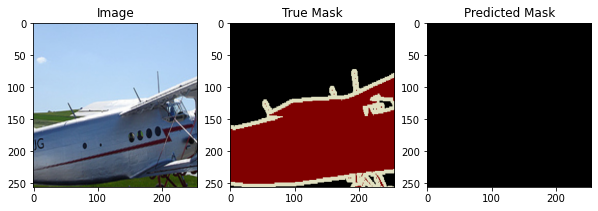

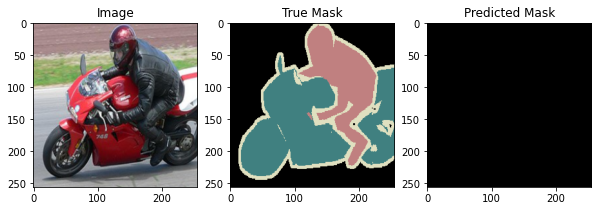

Epoch 12/100
1/1 [==============================] - 0s 358ms/step - loss: 2.7443 - accuracy: 0.0000e+00 - val_loss: 2.7897 - val_accuracy: 0.0000e+00


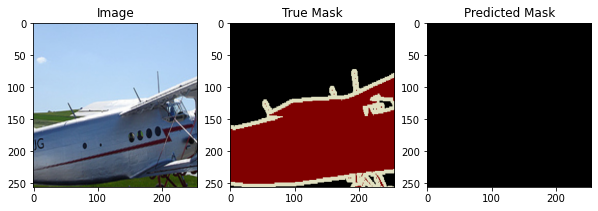

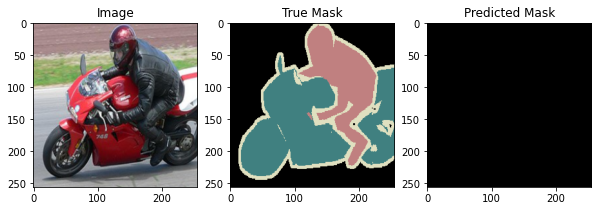

Epoch 13/100
1/1 [==============================] - 0s 485ms/step - loss: 2.5855 - accuracy: 0.0000e+00 - val_loss: 2.6506 - val_accuracy: 0.0000e+00


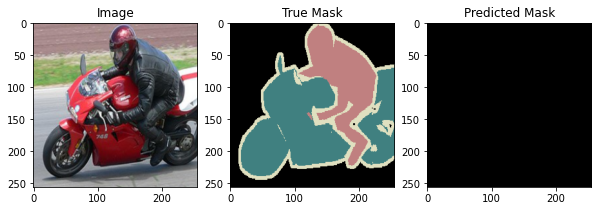

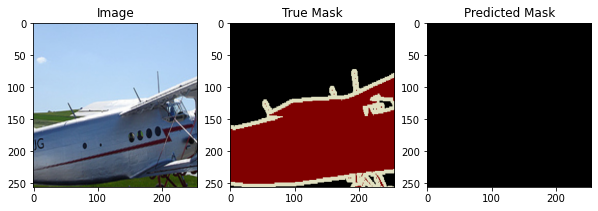

Epoch 14/100
1/1 [==============================] - 1s 634ms/step - loss: 2.3027 - accuracy: 0.0000e+00 - val_loss: 2.6537 - val_accuracy: 0.0000e+00


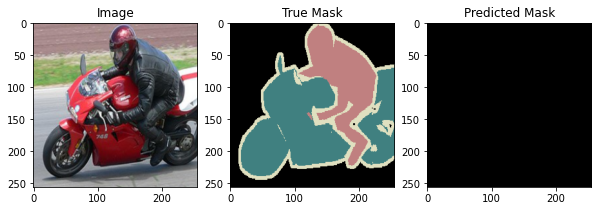

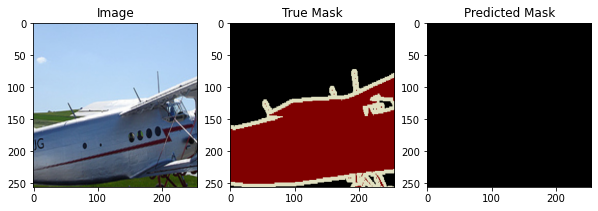

Epoch 15/100
1/1 [==============================] - 1s 625ms/step - loss: 1.9481 - accuracy: 0.0000e+00 - val_loss: 4.1717 - val_accuracy: 0.0000e+00


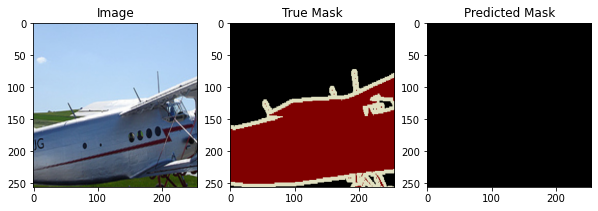

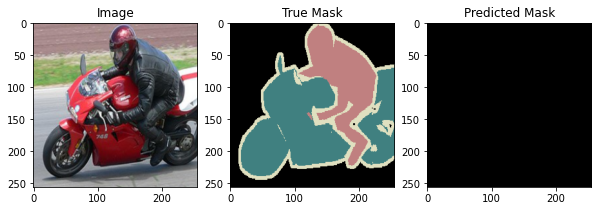

Epoch 16/100
1/1 [==============================] - 1s 650ms/step - loss: 2.4514 - accuracy: 0.0000e+00 - val_loss: 3.1516 - val_accuracy: 0.0000e+00


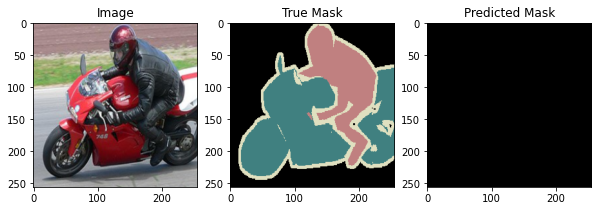

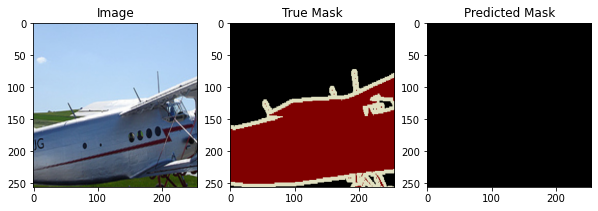

Epoch 17/100
1/1 [==============================] - 0s 357ms/step - loss: 1.8247 - accuracy: 0.0000e+00 - val_loss: 2.7578 - val_accuracy: 0.0000e+00


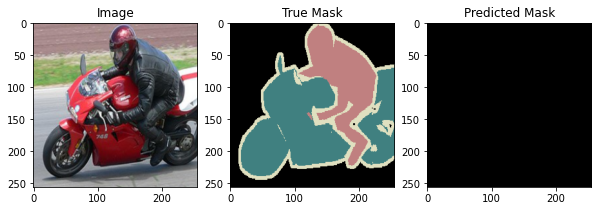

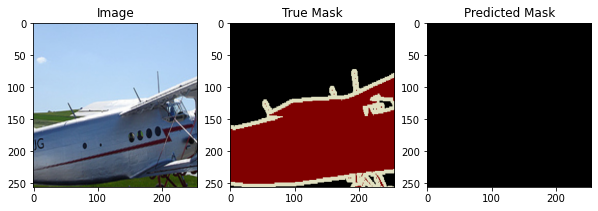

Epoch 18/100
1/1 [==============================] - 1s 646ms/step - loss: 1.7246 - accuracy: 0.0000e+00 - val_loss: 2.7299 - val_accuracy: 0.0000e+00


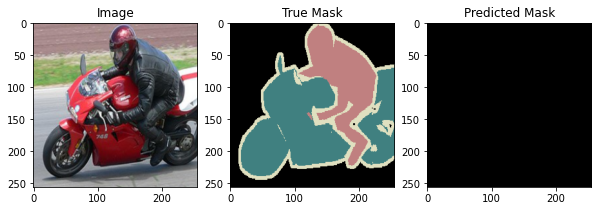

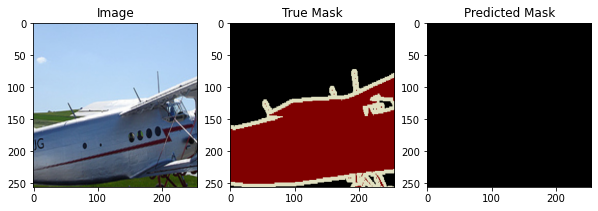

Epoch 19/100
1/1 [==============================] - 0s 483ms/step - loss: 1.7501 - accuracy: 0.0000e+00 - val_loss: 2.7879 - val_accuracy: 0.0000e+00


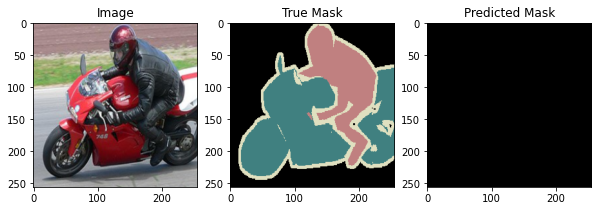

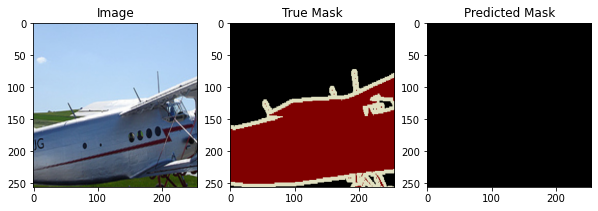

Epoch 20/100
1/1 [==============================] - 1s 607ms/step - loss: 1.6922 - accuracy: 0.0000e+00 - val_loss: 2.9534 - val_accuracy: 0.0000e+00


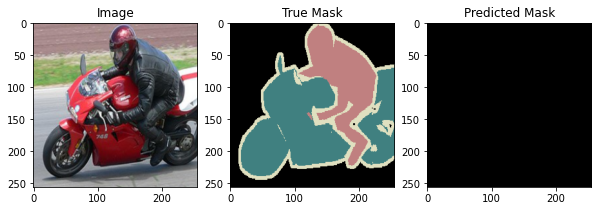

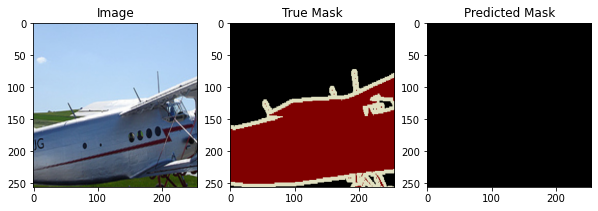

Epoch 21/100
1/1 [==============================] - 1s 649ms/step - loss: 1.5565 - accuracy: 0.0000e+00 - val_loss: 3.3930 - val_accuracy: 0.0000e+00


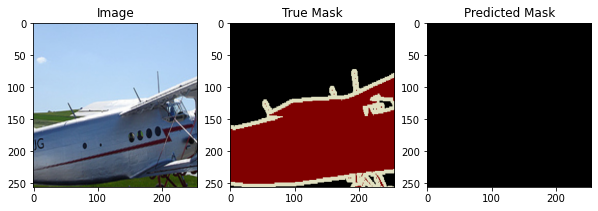

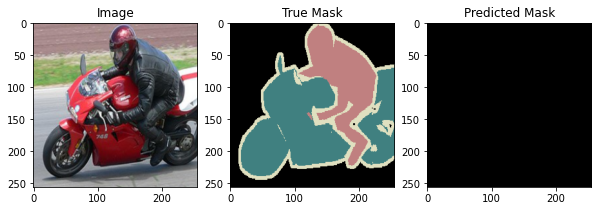

Epoch 22/100
1/1 [==============================] - 1s 608ms/step - loss: 1.4075 - accuracy: 0.0000e+00 - val_loss: 4.4241 - val_accuracy: 0.0000e+00


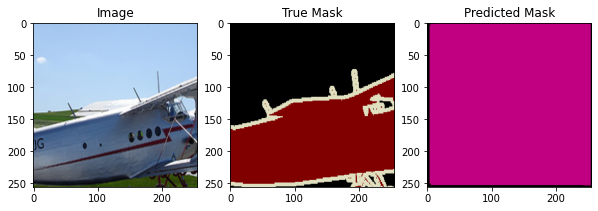

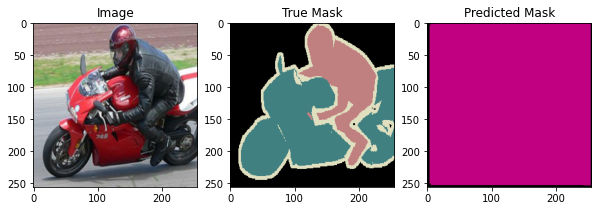

Epoch 23/100
1/1 [==============================] - 0s 335ms/step - loss: 1.3472 - accuracy: 0.0000e+00 - val_loss: 5.8791 - val_accuracy: 0.0000e+00


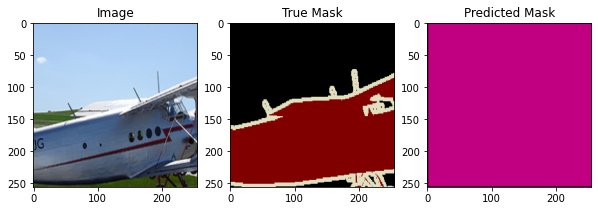

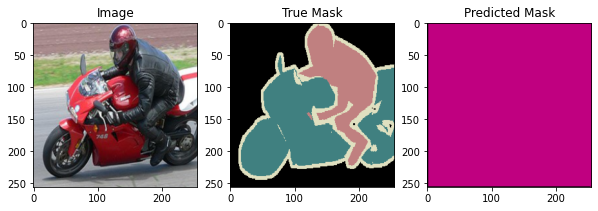

Epoch 24/100
1/1 [==============================] - 1s 606ms/step - loss: 1.4035 - accuracy: 0.0000e+00 - val_loss: 6.4938 - val_accuracy: 0.0000e+00


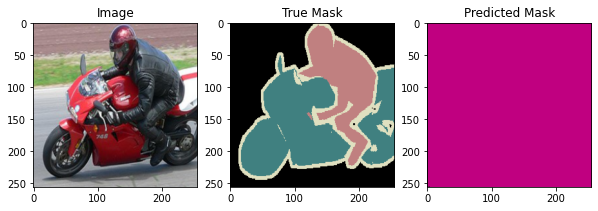

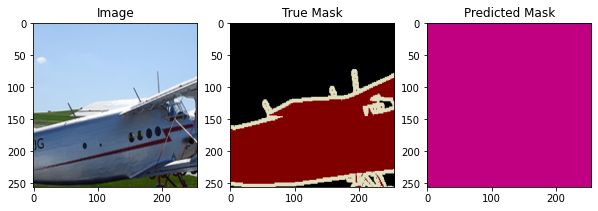

Epoch 25/100
1/1 [==============================] - 1s 615ms/step - loss: 1.4422 - accuracy: 0.0000e+00 - val_loss: 6.2270 - val_accuracy: 0.0000e+00


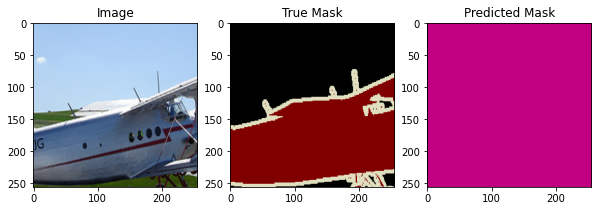

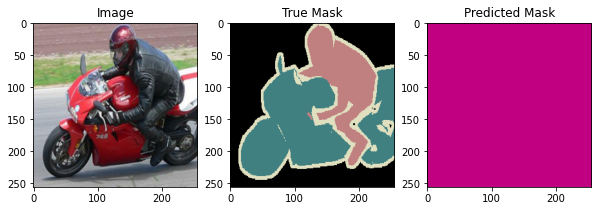

Epoch 26/100
1/1 [==============================] - 1s 592ms/step - loss: 1.4167 - accuracy: 0.0000e+00 - val_loss: 5.5571 - val_accuracy: 0.0000e+00


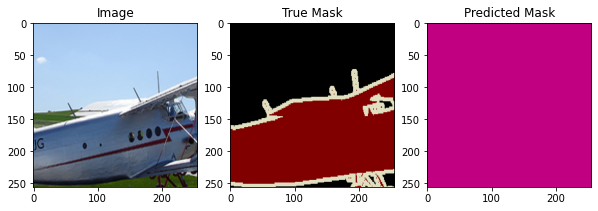

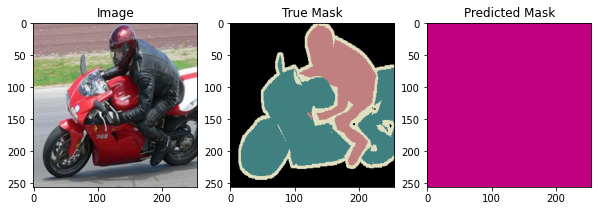

Epoch 27/100
1/1 [==============================] - 1s 612ms/step - loss: 1.3637 - accuracy: 0.0000e+00 - val_loss: 4.8550 - val_accuracy: 0.0000e+00


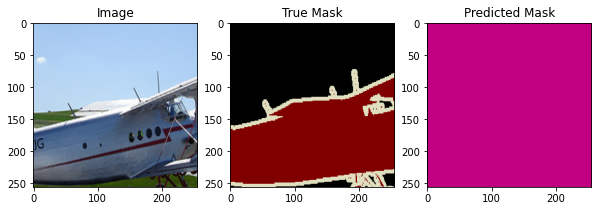

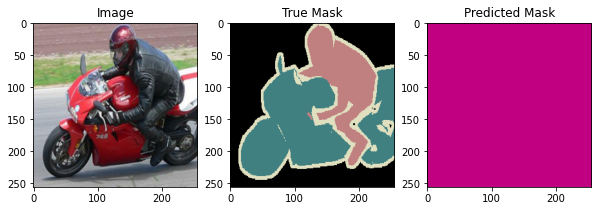

Epoch 28/100
1/1 [==============================] - 1s 609ms/step - loss: 1.3205 - accuracy: 0.0000e+00 - val_loss: 4.2828 - val_accuracy: 0.0000e+00


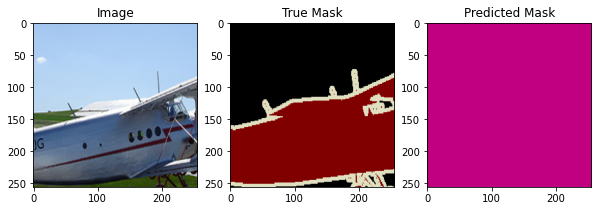

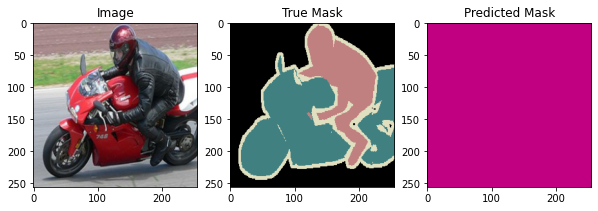

Epoch 29/100
1/1 [==============================] - 1s 650ms/step - loss: 1.3019 - accuracy: 0.0000e+00 - val_loss: 3.9376 - val_accuracy: 0.0000e+00


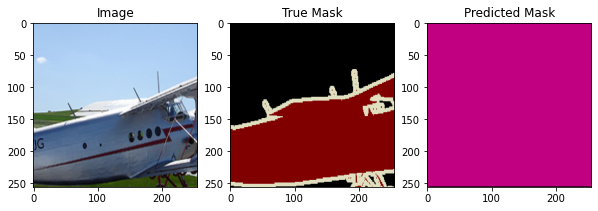

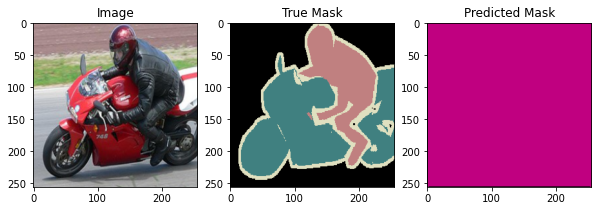

Epoch 30/100
1/1 [==============================] - 0s 478ms/step - loss: 1.3013 - accuracy: 0.0000e+00 - val_loss: 3.8304 - val_accuracy: 0.0000e+00


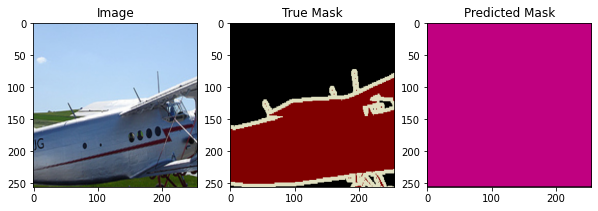

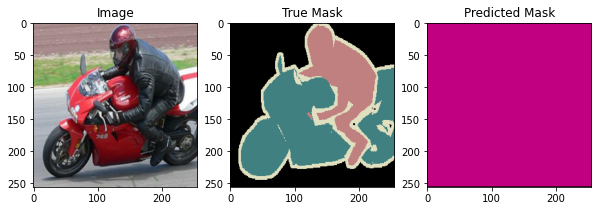

Epoch 31/100
1/1 [==============================] - 1s 556ms/step - loss: 1.2971 - accuracy: 0.0000e+00 - val_loss: 3.9126 - val_accuracy: 0.0000e+00


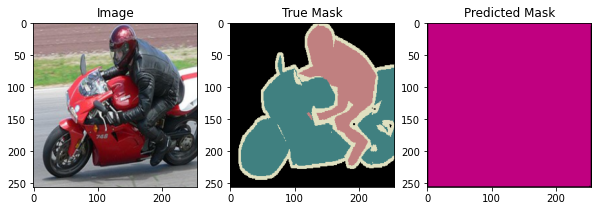

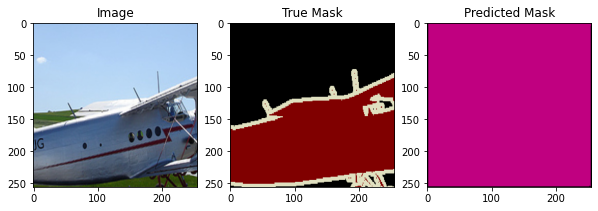

Epoch 32/100
1/1 [==============================] - 0s 358ms/step - loss: 1.2819 - accuracy: 0.0000e+00 - val_loss: 4.1463 - val_accuracy: 0.0000e+00


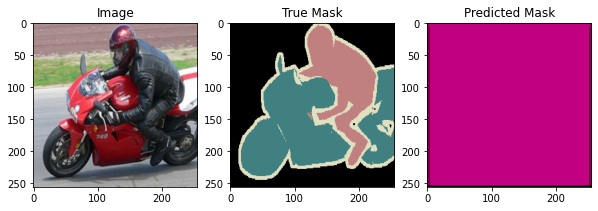

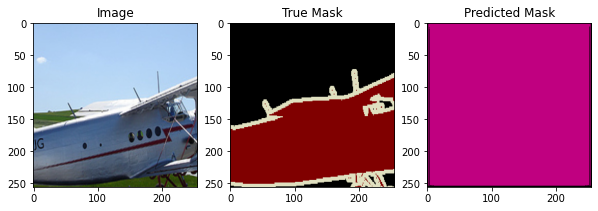

Epoch 33/100
1/1 [==============================] - 1s 617ms/step - loss: 1.2657 - accuracy: 0.0000e+00 - val_loss: 4.4766 - val_accuracy: 0.0000e+00


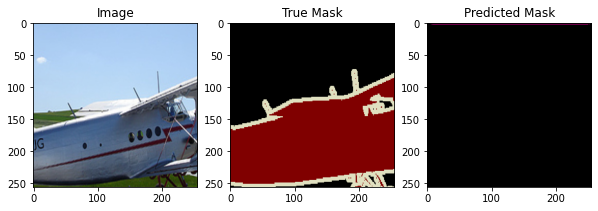

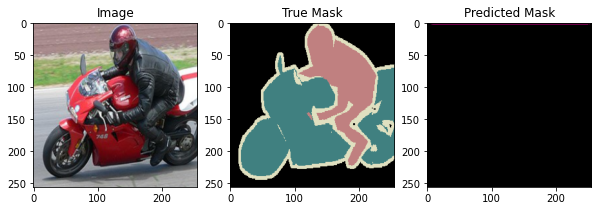

Epoch 34/100
1/1 [==============================] - 1s 607ms/step - loss: 1.2591 - accuracy: 0.0000e+00 - val_loss: 4.7830 - val_accuracy: 0.0000e+00


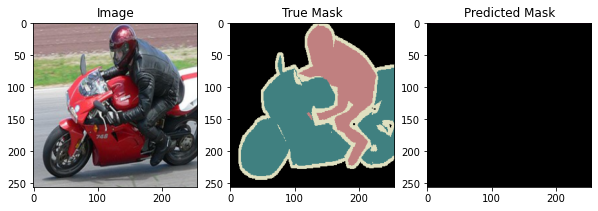

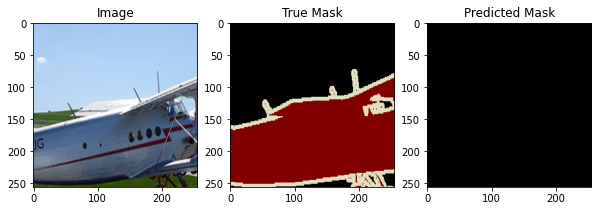

Epoch 35/100
1/1 [==============================] - 0s 472ms/step - loss: 1.2587 - accuracy: 0.0000e+00 - val_loss: 4.9810 - val_accuracy: 0.0000e+00


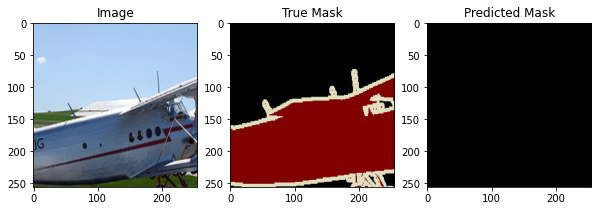

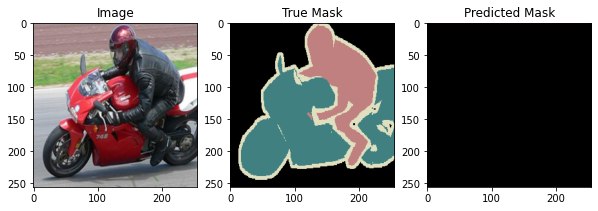

Epoch 36/100
1/1 [==============================] - 0s 487ms/step - loss: 1.2544 - accuracy: 0.0000e+00 - val_loss: 5.0604 - val_accuracy: 0.0000e+00


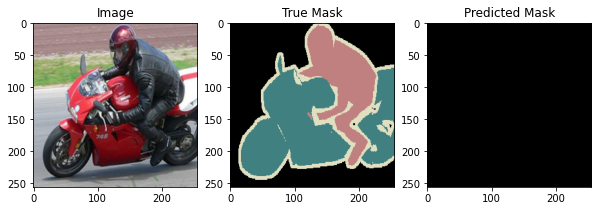

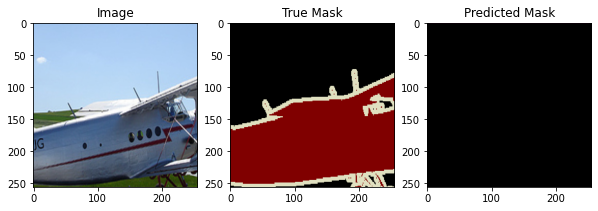

Epoch 37/100
1/1 [==============================] - 0s 476ms/step - loss: 1.2486 - accuracy: 0.0000e+00 - val_loss: 5.0796 - val_accuracy: 0.0000e+00


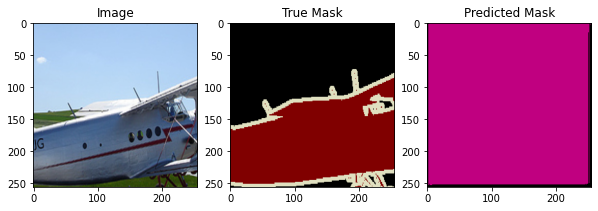

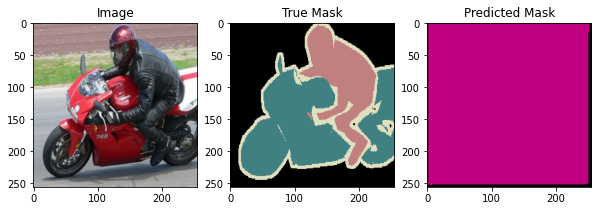

Epoch 38/100
1/1 [==============================] - 1s 603ms/step - loss: 1.2342 - accuracy: 0.0000e+00 - val_loss: 5.0884 - val_accuracy: 0.0000e+00


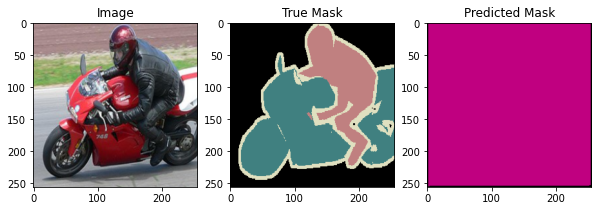

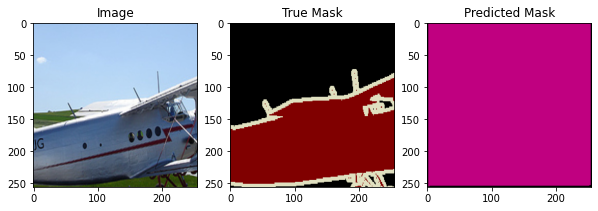

Epoch 39/100
1/1 [==============================] - 1s 612ms/step - loss: 1.2263 - accuracy: 0.0000e+00 - val_loss: 5.1287 - val_accuracy: 0.0000e+00


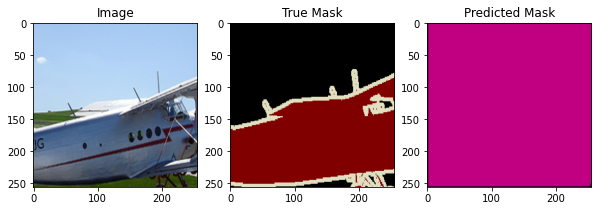

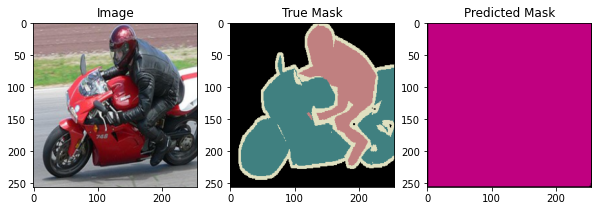

Epoch 40/100
1/1 [==============================] - 1s 603ms/step - loss: 1.2231 - accuracy: 0.0000e+00 - val_loss: 5.2079 - val_accuracy: 0.0000e+00


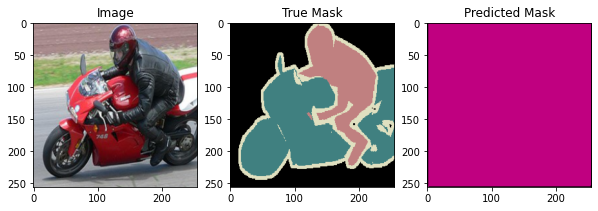

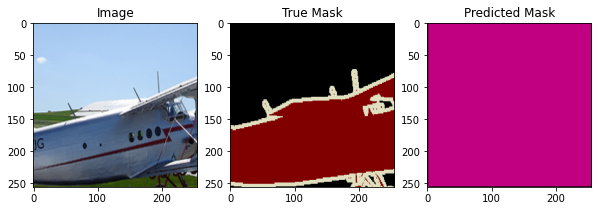

Epoch 41/100
1/1 [==============================] - 1s 607ms/step - loss: 1.2218 - accuracy: 0.0000e+00 - val_loss: 5.3328 - val_accuracy: 0.0000e+00


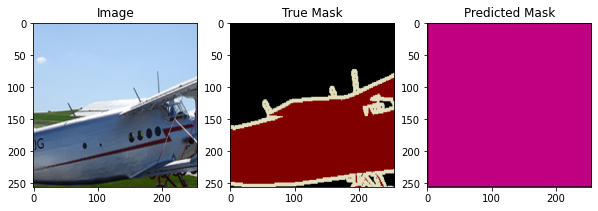

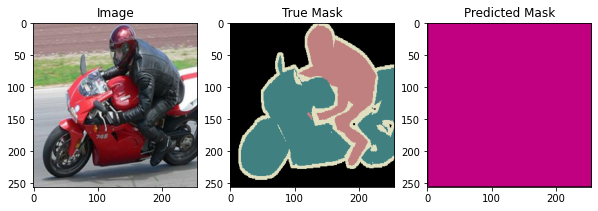

Epoch 42/100
1/1 [==============================] - 1s 599ms/step - loss: 1.2203 - accuracy: 0.0000e+00 - val_loss: 5.5234 - val_accuracy: 0.0000e+00


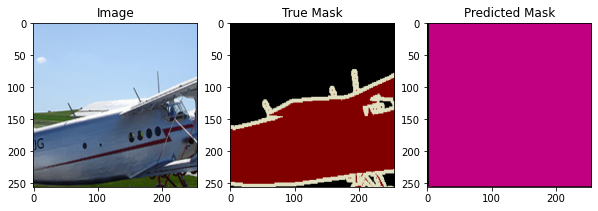

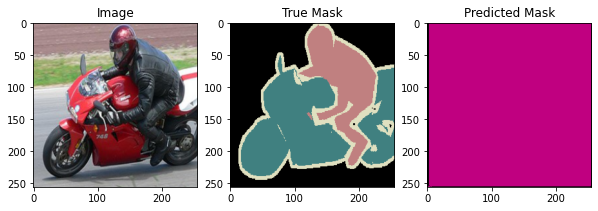

Epoch 43/100
1/1 [==============================] - 0s 491ms/step - loss: 1.2181 - accuracy: 0.0000e+00 - val_loss: 5.8062 - val_accuracy: 0.0000e+00


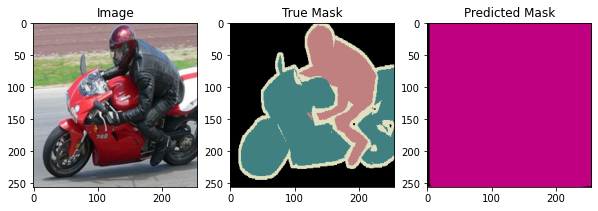

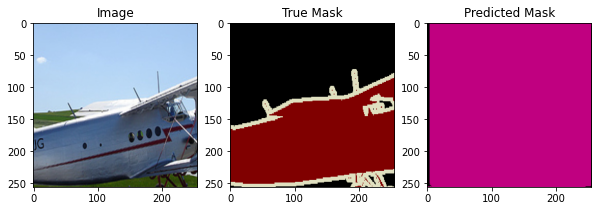

Epoch 44/100
1/1 [==============================] - 1s 603ms/step - loss: 1.2161 - accuracy: 0.0000e+00 - val_loss: 6.2203 - val_accuracy: 0.0000e+00


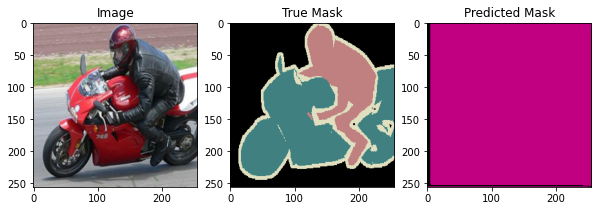

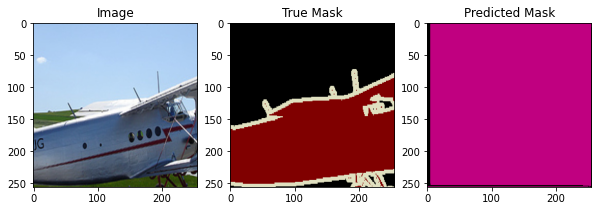

Epoch 45/100
1/1 [==============================] - 1s 596ms/step - loss: 1.2132 - accuracy: 0.0000e+00 - val_loss: 6.7812 - val_accuracy: 0.0000e+00


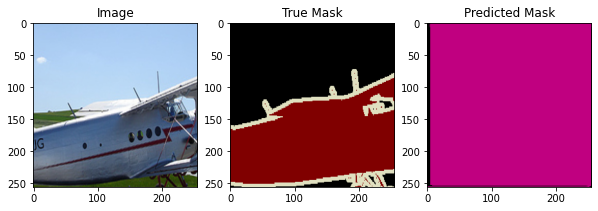

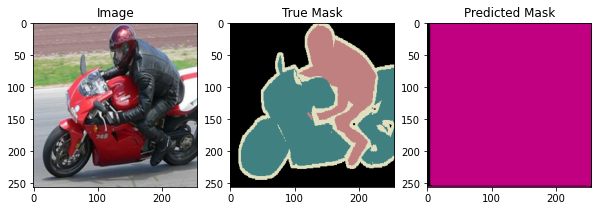

Epoch 46/100
1/1 [==============================] - 1s 624ms/step - loss: 1.2090 - accuracy: 0.0000e+00 - val_loss: 7.5023 - val_accuracy: 0.0000e+00


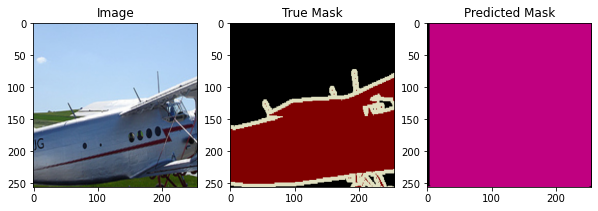

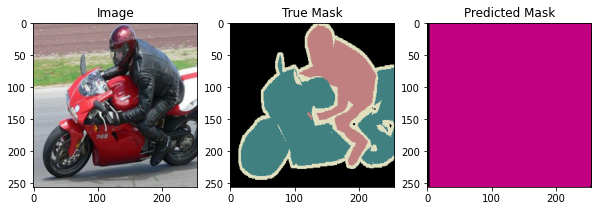

Epoch 47/100
1/1 [==============================] - 1s 650ms/step - loss: 1.2074 - accuracy: 0.0000e+00 - val_loss: 8.2269 - val_accuracy: 0.0000e+00


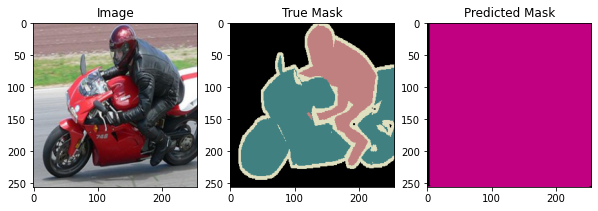

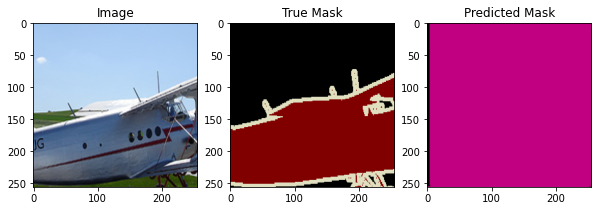

Epoch 48/100
1/1 [==============================] - 0s 340ms/step - loss: 1.2084 - accuracy: 0.0000e+00 - val_loss: 8.7223 - val_accuracy: 0.0000e+00


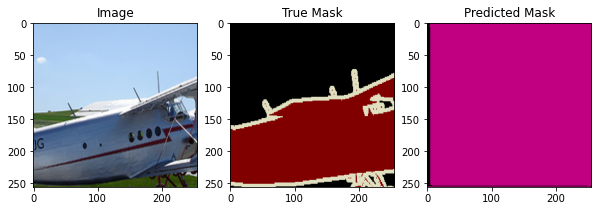

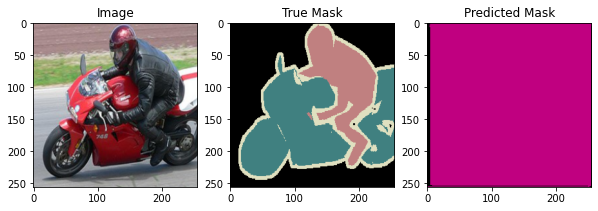

Epoch 49/100
1/1 [==============================] - 1s 543ms/step - loss: 1.2071 - accuracy: 0.0000e+00 - val_loss: 8.9921 - val_accuracy: 0.0000e+00


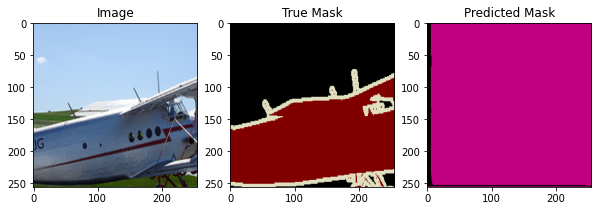

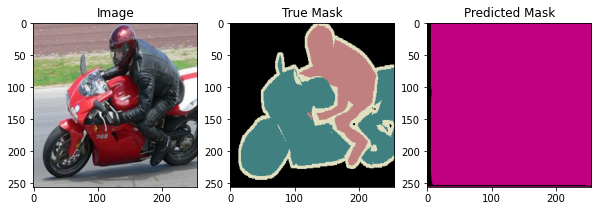

Epoch 50/100
1/1 [==============================] - 1s 774ms/step - loss: 1.2055 - accuracy: 0.0000e+00 - val_loss: 9.2093 - val_accuracy: 0.0000e+00


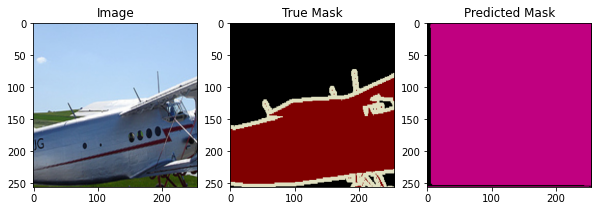

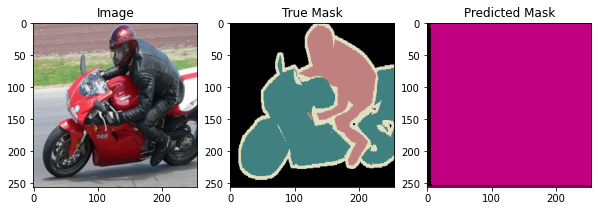

Epoch 51/100
1/1 [==============================] - 0s 332ms/step - loss: 1.2045 - accuracy: 0.0000e+00 - val_loss: 9.5430 - val_accuracy: 0.0000e+00


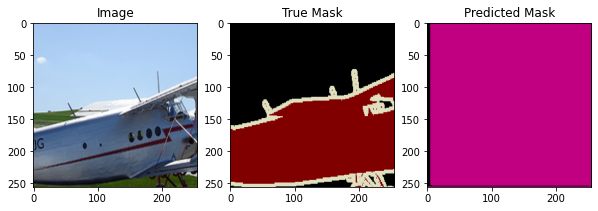

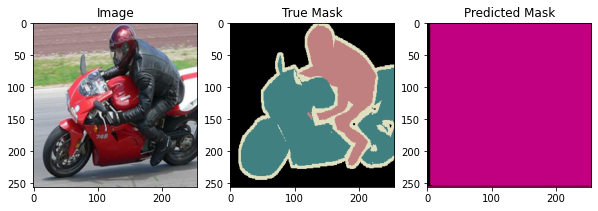

Epoch 52/100
1/1 [==============================] - 0s 487ms/step - loss: 1.2053 - accuracy: 0.0000e+00 - val_loss: 9.9929 - val_accuracy: 1.5259e-05


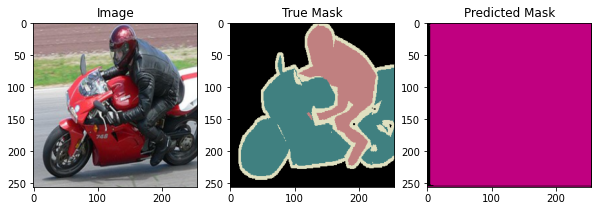

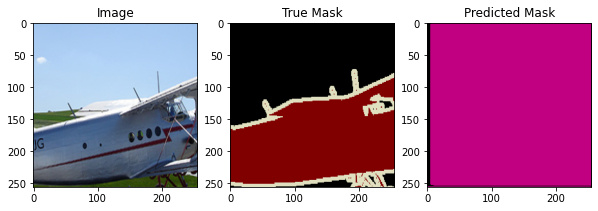

Epoch 53/100
1/1 [==============================] - 1s 602ms/step - loss: 1.2036 - accuracy: 1.5259e-05 - val_loss: 10.5492 - val_accuracy: 1.5259e-05


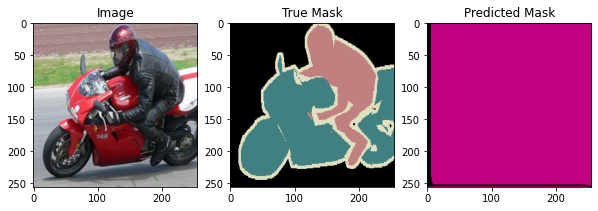

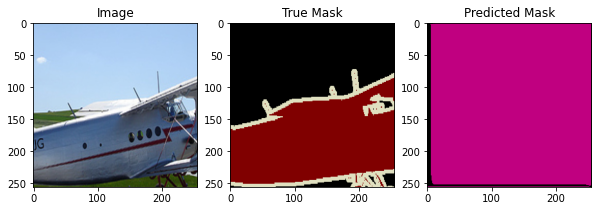

Epoch 54/100
1/1 [==============================] - 1s 607ms/step - loss: 1.2024 - accuracy: 1.5259e-05 - val_loss: 11.1515 - val_accuracy: 1.5259e-05


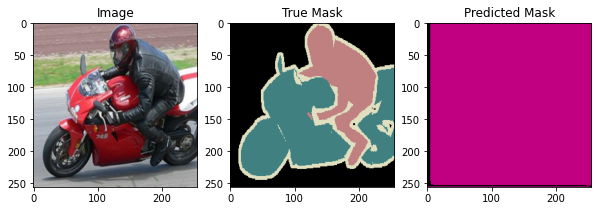

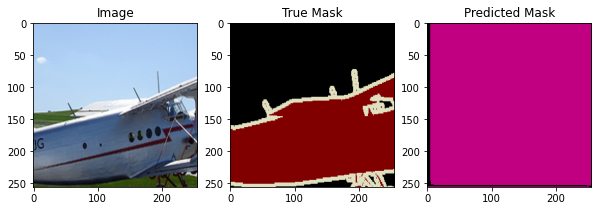

Epoch 55/100
1/1 [==============================] - 0s 355ms/step - loss: 1.2025 - accuracy: 1.5259e-05 - val_loss: 11.5697 - val_accuracy: 1.5259e-05


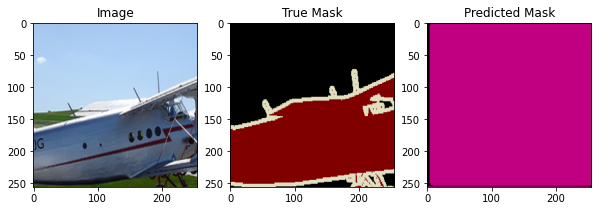

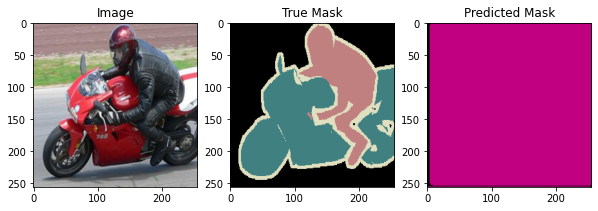

Epoch 56/100
1/1 [==============================] - 1s 603ms/step - loss: 1.2024 - accuracy: 1.5259e-05 - val_loss: 11.8059 - val_accuracy: 1.5259e-05


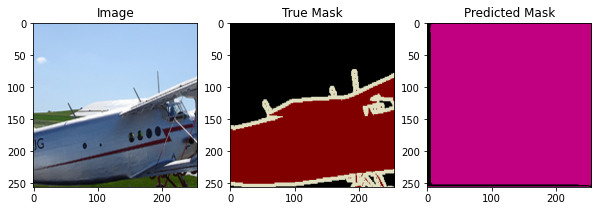

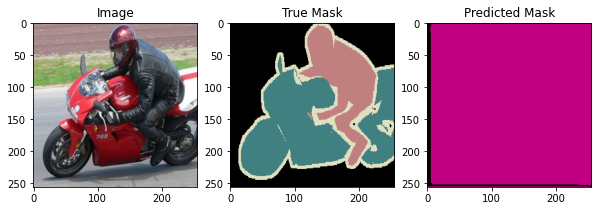

Epoch 57/100
1/1 [==============================] - 1s 633ms/step - loss: 1.2002 - accuracy: 1.5259e-05 - val_loss: 12.2123 - val_accuracy: 1.5259e-05


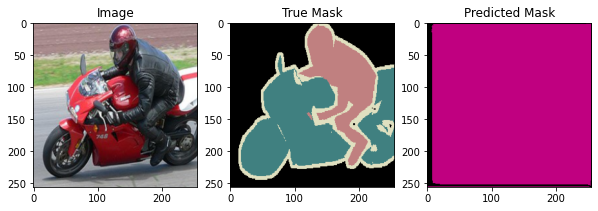

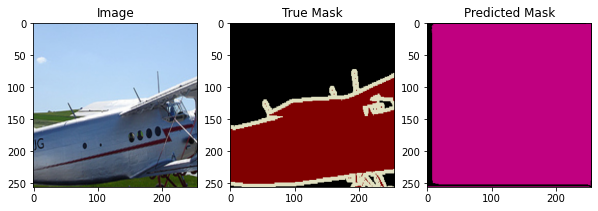

Epoch 58/100
1/1 [==============================] - 0s 348ms/step - loss: 1.2005 - accuracy: 1.5259e-05 - val_loss: 12.9844 - val_accuracy: 1.5259e-05


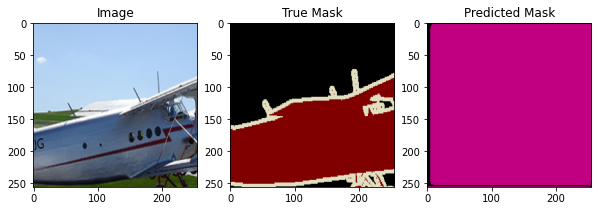

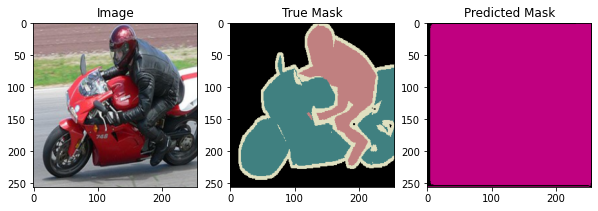

Epoch 59/100
1/1 [==============================] - 1s 616ms/step - loss: 1.1992 - accuracy: 1.5259e-05 - val_loss: 13.9996 - val_accuracy: 1.5259e-05


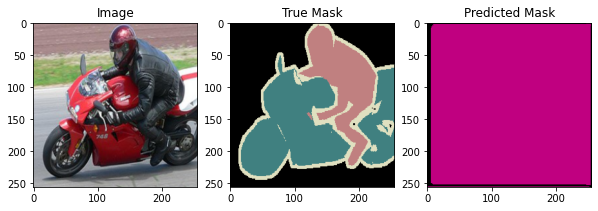

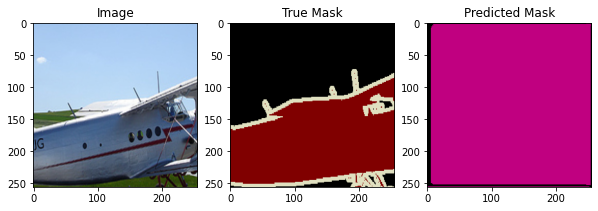

Epoch 60/100
1/1 [==============================] - 0s 348ms/step - loss: 1.1981 - accuracy: 1.5259e-05 - val_loss: 14.6215 - val_accuracy: 1.5259e-05


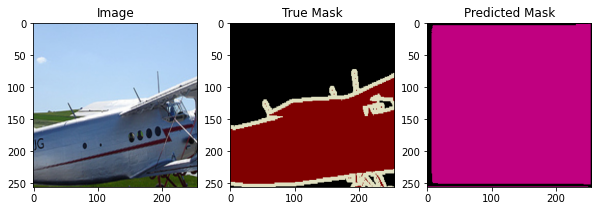

KeyboardInterrupt: 

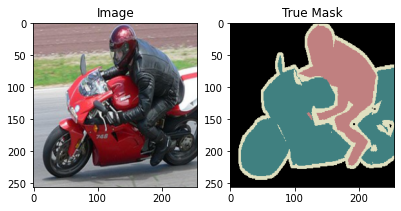

In [15]:
#regularizer added, not good as well

model2 = build_unet()
model2.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


history = model2.fit(train_generator, 
                    validation_data=val_generator, 
                    epochs=100, 
                    callbacks=[tensorboard_callback, model_checkpoint_callback, visualization_callback])


In [30]:
!tensorboard dev upload --logdir ./logs --name "unet?" --description "dumbest result ever" --one_shot


***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) ^C
Traceback (most recent call last):
  File "/opt/conda/bin/tensorboard", line 8, in <module>
    sys.exit(run_main())
  File "/opt/conda/lib/python3.9/site-packages/tensorboard/main.py", line 46, in run_main
    app.run(tensorboard.main, flags_parser=tensorboard.configure)
  File "/opt/conda/lib/python3.9/site-packages/absl/app.py", line 303, in run
    _run_main(main, args)
  File "/opt/conda/